In [ ]:
!pip install tensorflow==2.10 wandb 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 578.1/578.1 MB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 33.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 438.7/438.7 KB 21.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 59.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.9/178.9 KB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 20.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 8.9 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8806 sha256=4c49843404693307a7bf620034caf681be91c98ed9cd1154

In [ ]:
from tensorflow.keras.layers import LeakyReLU, Conv2D, Dropout , Concatenate ,UpSampling2D, SpatialDropout2D , GlobalAveragePooling2D  , Normalization, BatchNormalization , Activation   , AveragePooling2D  , MaxPooling2D, ZeroPadding2D , Dense , Add , ZeroPadding2D  , Input ,Flatten , Reshape
from tensorflow.keras.models import Model , Sequential
import tensorflow as tf 
import tensorflow.keras.backend as K 
from tensorflow.keras import mixed_precision
from tensorflow.keras.regularizers import L2
from tensorflow.keras.callbacks import ReduceLROnPlateau
import gc
from sklearn.model_selection import train_test_split
# mixed_precision.set_global_policy('mixed_float16')
IMG_SIZE = 28
import matplotlib.pyplot as plt
tf.random.set_seed(42)



## Architecture


### `Conv2dTranspose` layers are avoided from the start 
- Conv2dTranspose layers with stride of 2 can upsample the images by doubling the size of them, but will produce artifact

https://distill.pub/2016/deconv-checkerboard/

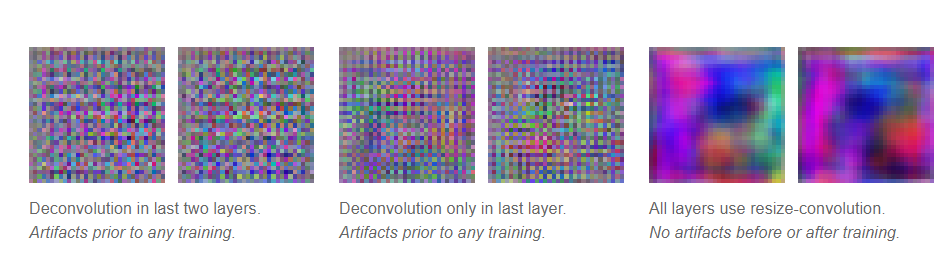

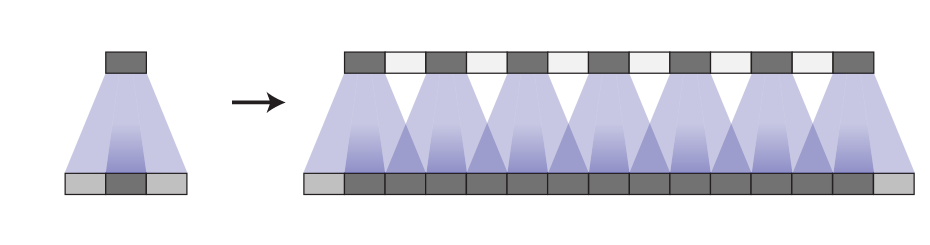



- This shows that the convtranspose2d will produce artifacts (checkerboard patterns) , and it is due to the uneven overlap of the layers and not due to the adversarial training 


##### Training result of a GAN with Conv2D Transpose

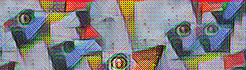

- I do not wish to create a GAN where the images generally look alright but the artifacts make it obivious that the images are computer generated
- Hence I decided to use Upsampling Layers with normal Conv2d layers after to avoid artifacts, 
- 

### BCE GAN without Conditioning 
https://github.com/soumith/ganhacks
Architecture:
- No skip connections

- Blocks of Upsampling layers with convolution layers afterwards
- Using Leaky ReLu (sparse gradients caused by normal ReLu causes instability  
- Using Batch Normalisation in both generator and discrminator will make convergence faster in gan

Hyperparameters:
- Adam optimizer with 0.0002 learning rate  as the original learning rate of 0.001 is too large, and often causes divergence


In [ ]:
from tensorflow.python.util.nest import pack_sequence_as
import tensorflow.keras.models as KM
import tensorflow as tf

import wandb
import warnings

from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras import backend as K
import numpy as np

class KID(keras.metrics.Metric):
	#https://keras.io/examples/generative/gan_ada/ 
    def __init__(self, name="kid", **kwargs):
        super().__init__(name=name, **kwargs)

        # KID is estimated per batch and is averaged across batches
        self.kid_tracker = keras.metrics.Mean()

        # a pretrained InceptionV3 is used without its classification layer
        # transform the pixel values to the 0-255 range, then use the same
        # preprocessing as during pretraining
        self.encoder = keras.Sequential(
            [
                layers.InputLayer(input_shape=(32, 32, 3)),
                # layers.Rescaling(255.0),
                layers.Resizing(height=75, width=75),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(75, 75, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype=tf.float32)
        return (features_1 @ tf.transpose(features_2) / feature_dimensions + 1.0) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        # compute polynomial kernels using the two sets of features
        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        # estimate the squared maximum mean discrepancy using the average kernel values
        batch_size = tf.shape(real_features)[0]
        batch_size_f = tf.cast(batch_size, dtype=tf.float32)
        mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = tf.reduce_sum(
            kernel_generated * (1.0 - tf.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = tf.reduce_mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        # update the average KID estimate
        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()


class ImageLogger(tf.keras.callbacks.Callback):
	def __init__(self, num_row=6 , num_col = 10, latent_dim=128):
		self.num_rows = num_row
		self.latent_dim = latent_dim
		self.num_cols = num_col


	def on_epoch_end(self, epoch, logs=None):



		random_latent_vectors = tf.random.normal(shape=(self.num_rows * self.num_cols , self.latent_dim))
		generated_images = self.model.generator(random_latent_vectors).numpy() 
		generated_images = (generated_images +1 ) /2 
		plt.figure(figsize=(self.num_cols * 1.0, self.num_rows * 1.0))
		for row in range(self.num_rows):
			for col in range(self.num_cols):
				index = row * self.num_cols + col
				plt.subplot(self.num_rows, self.num_cols, index + 1)
				plt.imshow(generated_images[index] )
				plt.axis("off")
		plt.tight_layout()
		plt.show()
		plt.close()
import os 
import shutil
class WandbModelLogger(tf.keras.callbacks.Callback):
	def __init__(self, num_row=6 , num_col = 10, latent_dim=128):
		pack_sequence_as
		# self.generator_artifact = wandb.Artifact( name = wandb.run.name + ' Generator', type = 'model')
		# self.discriminator_artifact = wandb.Artifact( name = wandb.run.name + ' discriminator', type = 'model')
	



	def on_epoch_end(self, epoch, logs=None):
		if self.model.kid.name in logs:

			disstr = f"Discriminator-Epoch{epoch},KID={logs[self.model.kid.name]}"
			genstr = f"Generator-Epoch{epoch},KID={logs[self.model.kid.name]}"
		else:

			disstr = f"Discriminator-Epoch{epoch}"
			genstr = f"Generator-Epoch{epoch}"
		
		self.model.discriminator.save(disstr,save_format="tf")
		self.model.generator.save(genstr	, save_format="tf")
		# self.model.save(self.filepath[:-3], overwrite=True, save_format="tf")

        # Log the model as artifact.
		dis_name = wandb.util.make_artifact_name_safe(f"Discriminator-{wandb.run.name}")
		gen_name = wandb.util.make_artifact_name_safe(f"Generator-{wandb.run.name}")
		dis_artifact = wandb.Artifact(dis_name, type="model")
		gen_artifact = wandb.Artifact(gen_name, type="model")
  


		dis_artifact.add_dir(disstr)
		gen_artifact.add_dir(genstr)
		wandb.run.log_artifact(dis_artifact, aliases=["latest", f"Discriminator_epoch_{epoch}"])
		wandb.run.log_artifact(gen_artifact, aliases=["latest", f"Generator_epoch_{epoch}"])

		# Remove the SavedModel from wandb dir as we don't want to log it to save memory.
		shutil.rmtree(disstr)
		shutil.rmtree(genstr)
	# # import shutil
	# 	shutil.make_archive(disstr , 'zip', disstr)
	# 	shutil.make_archive(genstr , 'zip', genstr)
		
	
		
	# 	wandb.save( disstr + '.zip' , policy = 'now')
	# 	wandb.save(genstr+ '.zip' , policy = 'now')
	
	# 	shutil.rmtree(disstr )
	# 	shutil.rmtree(genstr)
	# 	os.remove( disstr+ '.zip')
	# 	os.remove(genstr+ '.zip')





#https://medium.com/dive-into-ml-ai/customization-of-model-fit-to-write-a-combined-discriminator-generator-gan-trainer-in-keras-524bce10cf66
class GAN(KM.Model):
	def __init__(self, discriminator, generator , latdim ,*args):
		super().__init__()
		self.discriminator = discriminator
		self.generator= generator
		self.latent_dim = latdim
		# self.val_data = val_data
		self.fid_history = dict(epoch = list() , fidscore = list() ) 
		self.test_step_counter = tf.Variable( 0, tf.int32)
  
	@property
	def metrics(self):
		return [self.kid]



	def compile(self, optimizers, loss):
		super().compile()

		# Optimizer for discriminator
		self.d_optimizer = optimizers["d_optimizer"]
		# Optimizer for generator
		self.g_optimizer = optimizers["g_optimizer"]

		# Loss for the main objective
		self.g_loss = loss["g_loss"]
		# Discriminator loss
		self.d_loss = loss["d_loss"]
		self.kid = KID()
		# self.fid = FID() 

		# self.metrics = metrics 

	def fit(self, *args, **kwargs):
		self.img = args[0] if len(args) >= 1 else kwargs['x']
		self.fid_history['epoch'] = list() 
		self.fid_history['fidscore'] = list() 
		self.test_step_per_epoch= tf.constant(kwargs['test_step_per_epoch'], tf.int32)
		del kwargs['test_step_per_epoch']
		return super().fit( *args, **kwargs)
  

	def test_step(self, real_images):
		if isinstance(real_images, tuple):
			real_images = real_images[0]
		
		batch_size = tf.shape(real_images)[0]
		latent_samples = tf.random.normal(shape=(batch_size, self.latent_dim))
		generated_images = self.generator(latent_samples, training=False)
     

		self.kid.update_state(real_images, (generated_images+1)/2)


		# only KID is measured during the evaluation phase for computational efficiency
		return {self.kid.name: self.kid.result() } 


	def train_step(self, real_images):
		if isinstance(real_images, tuple):
			real_images = real_images[0]
		# Sample random points in the latent space
		batch_size = tf.shape(real_images)[0]
		random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

		# Decode them to fake images
		generated_images = self.generator(random_latent_vectors , training = True)


		# Add random noise to the labels - important trick!
		# labels += 0.05 * tf.random.uniform(tf.shape(labels))

		# Train the discriminator
		def train_discriminator(label, img):
			with tf.GradientTape() as tape:
				predictions = self.discriminator(img, training = True)
				d_loss = self.d_loss(label, predictions)
				# d_loss_scaled = self.d_optimizer.get_scaled_loss(d_loss)
			grads = tape.gradient(d_loss, self.discriminator.trainable_weights)




			# grads = self.d_optimizer.get_unscaled_gradients( scaled_grads)
			self.d_optimizer.apply_gradients(
				zip(grads, self.discriminator.trainable_weights)
			)
            

			del predictions  , grads , tape , label
			return d_loss 
		d_loss_fake = train_discriminator(tf.ones((batch_size, 1)) +0.05 * tf.random.uniform((batch_size, 1)), generated_images)
		d_loss_real=train_discriminator(tf.zeros((batch_size, 1)) +0.05 * tf.random.uniform((batch_size, 1)), real_images)
		d_loss = 0.5*(d_loss_fake+d_loss_real)


		# Sample random points in the latent space


		random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

		# Assemble labels that say "all real images"
		misleading_labels = tf.zeros((batch_size, 1))

		# Train the generator
		# Do not update the discriminator weights

		with tf.GradientTape() as tape:
			predictions = self.discriminator(self.generator(random_latent_vectors, training = True), training = True)
			g_loss = self.g_loss(misleading_labels, predictions)
		grads  = tape.gradient(g_loss, self.generator.trainable_weights)
		self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))
		del predictions, grads  , tape , misleading_labels 
		return {"d_loss": d_loss, "g_loss": g_loss}









	
	


In [ ]:



def vggblock(x , n_conv, n_filters):
    for _ in range(n_conv-1 ):
        x = Conv2D(filters=n_filters,kernel_size=(3,3),padding="same")(x)
        x= BatchNormalization(momentum=0.1)(x)
        x = LeakyReLU(0.2)(x)
        

    x =  Conv2D(filters=n_filters,kernel_size=(3,3), strides = 2 ,padding="same" )(x)
    x= BatchNormalization(momentum=0.1)(x)
    x= LeakyReLU(0.2)(x)
    
    return x
def createcustomvgg_discriminator():#real vs fake classification
    inputtensor = Input(shape=(32,32,3))
    # x = vggblock(inputtensor, 2, 16)
    # x= MaxPooling2D((2,2) , strides =2 )(x)
  
    x = vggblock(inputtensor , 1 , 32)
    # x= MaxPooling2D((2,2) , strides =2 )(x)
    x = SpatialDropout2D(0.2)(x)
    x = vggblock(x , 1 , 64)
    # x =  MaxPooling2D((2,2) , strides =2 )(x)
    x = SpatialDropout2D(0.3)(x)
    x = vggblock(x , 1 , 128)
    # x = MaxPooling2D((2,2) , strides =2 )(x)
    x = SpatialDropout2D(0.3)(x)
    x = vggblock(x, 1, 256)
    x = GlobalAveragePooling2D()(x)
    # x = Dropout(0.5)(x)
    x= Dense(1 , 'sigmoid')(x)
    return Model( inputs = [inputtensor] , outputs = [x])



def gen_block(x, filters , n_conv, last  = False, kernel_size=(3, 3), strides=(1, 1), up_size=(2, 2)):
   
        # x = BatchNormalization()(x)

    
    x = UpSampling2D(up_size, interpolation='bilinear')(x)
    x = Conv2D(filters, kernel_size, strides=strides, padding='same', use_bias=False )(x)
    x= BatchNormalization(momentum=0.1)(x)
    x =  tf.keras.layers.ReLU()(x)
    for _ in range(n_conv-1):
        x = Conv2D(filters, kernel_size, strides=strides, padding='same', use_bias=False )(x)
        x= BatchNormalization(momentum=0.1)(x) 
        x =  tf.keras.layers.ReLU()(x)
       

    
    # x = BatchNormalization()(x)

    # if  not last:
    #     x =  tf.keras.layers.ReLU()(x)
    
    # if use_dropout:
    #     x = layers.Dropout(drop_value)(x)
        
    return x
from tensorflow.keras.layers import SpatialDropout2D
def create_generator():
    inputtensor = Input( shape = (100, ))
    x = Dense(2 * 2 * 512, use_bias=False)(inputtensor)
    # x  = BatchNormalization()(x)
    x =  tf.keras.layers.ReLU()(x)
    x = Reshape( (2,2,512))(x )
    x = gen_block(x, 256 , 1)

    x = gen_block(x, 128 ,2  )#height width  8x8 
    x = gen_block(x, 64 ,3)#height width  16x16
    # x = SpatialDropout2D(0.3)(x)
    x = gen_block(x, 32  , 3, last = True )#height width  32 x 32
    x = Conv2D(3, (1,1 ), strides=1,  padding='same', use_bias=False , activation ='tanh' )(x) # 32 x 32 x 3
    return Model( inputs =  [inputtensor] , outputs = [x ])

# lossgen 
# lossdiscriminator 

# optimgen 

# optimdiscriminator 



In [ ]:
testgen = create_generator()
testgen.summary() 

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 dense (Dense)               (None, 2048)              204800    
                                                                 
 re_lu (ReLU)                (None, 2048)              0         
                                                                 
 reshape (Reshape)           (None, 2, 2, 512)         0         
                                                                 
 up_sampling2d (UpSampling2D  (None, 4, 4, 512)        0         
 )                                                               
                                                                 
 conv2d (Conv2D)             (None, 4, 4, 256)         1179648   
                                                             

In [ ]:
createcustomvgg_discriminator().summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 conv2d_11 (Conv2D)          (None, 16, 16, 32)        896       
                                                                 
 batch_normalization_10 (Bat  (None, 16, 16, 32)       128       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 32)        0         
                                                                 
 spatial_dropout2d_2 (Spatia  (None, 16, 16, 32)       0         
 lDropout2D)                                                     
                                                                 
 conv2d_12 (Conv2D)          (None, 8, 8, 64)          1849

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


87910968/87910968 [==============================] - 3s 0us/step


wandb: Currently logged in as: yh1234. Use `wandb login --relogin` to force relogin


Epoch 1/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6914 - g_loss: 0.7243

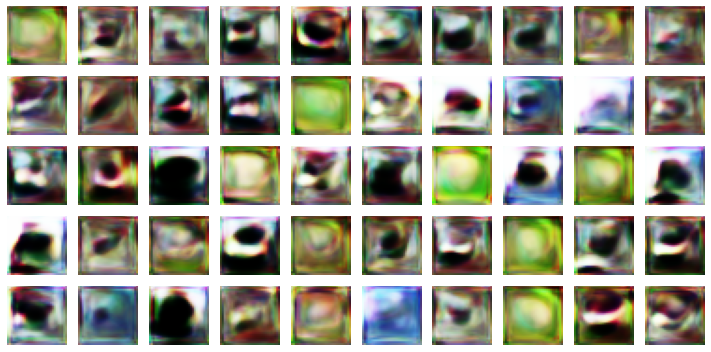

wandb: Adding directory to artifact (./Discriminator-Epoch0)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch0)... Done. 0.0s


391/391 [==============================] - 54s 106ms/step - d_loss: 0.6914 - g_loss: 0.7244 - val_kid: 0.0361
Epoch 2/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6860 - g_loss: 0.7699

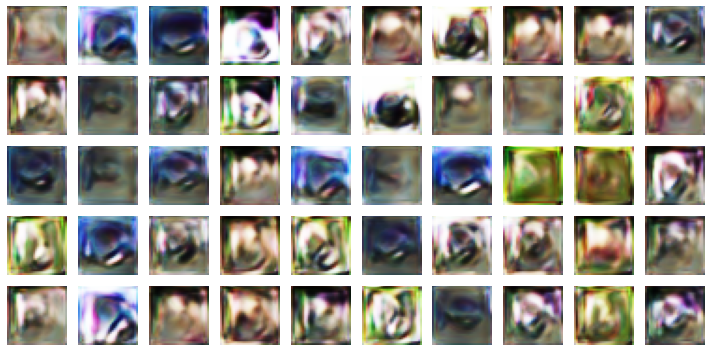

wandb: Adding directory to artifact (./Discriminator-Epoch1)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch1)... Done. 0.0s


391/391 [==============================] - 35s 90ms/step - d_loss: 0.6861 - g_loss: 0.7698 - val_kid: 0.0510
Epoch 3/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6881 - g_loss: 0.7743

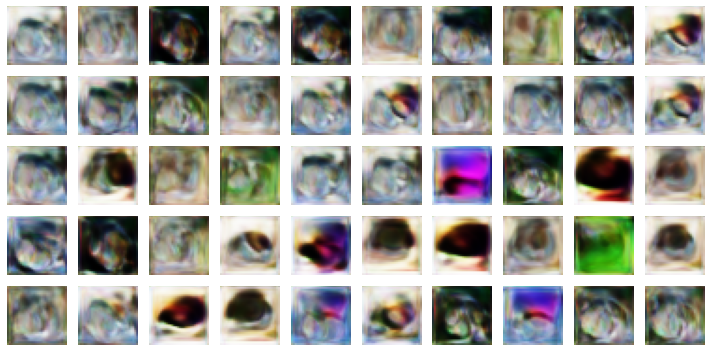

wandb: Adding directory to artifact (./Discriminator-Epoch2)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch2)... Done. 0.0s


391/391 [==============================] - 34s 87ms/step - d_loss: 0.6882 - g_loss: 0.7744 - val_kid: 0.0318
Epoch 4/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6861 - g_loss: 0.7728

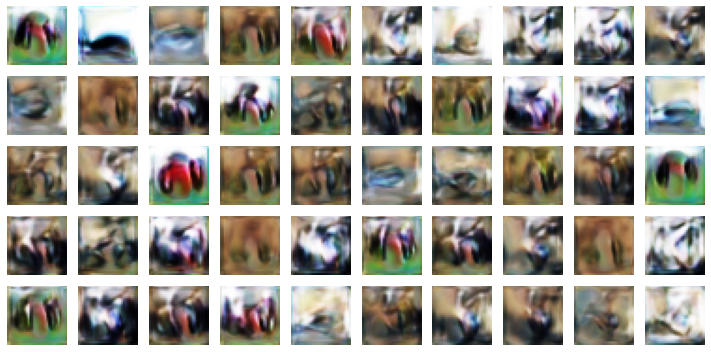

wandb: Adding directory to artifact (./Discriminator-Epoch3)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch3)... Done. 0.0s


391/391 [==============================] - 34s 88ms/step - d_loss: 0.6860 - g_loss: 0.7727 - val_kid: 0.0297
Epoch 5/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6875 - g_loss: 0.7704

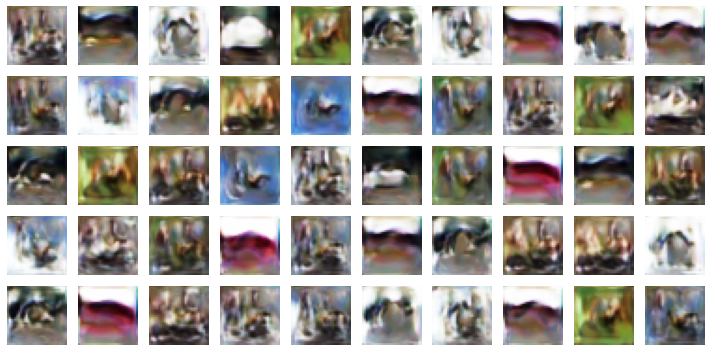

wandb: Adding directory to artifact (./Discriminator-Epoch4)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch4)... Done. 0.0s


391/391 [==============================] - 35s 89ms/step - d_loss: 0.6875 - g_loss: 0.7704 - val_kid: 0.0148
Epoch 6/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6853 - g_loss: 0.7758

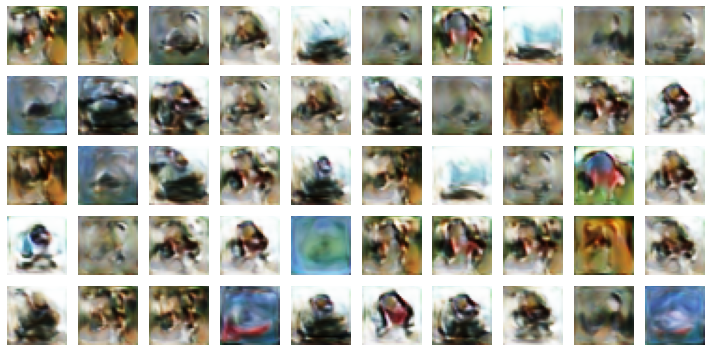

wandb: Adding directory to artifact (./Discriminator-Epoch5)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch5)... Done. 0.0s


391/391 [==============================] - 34s 88ms/step - d_loss: 0.6853 - g_loss: 0.7756 - val_kid: 0.0191
Epoch 7/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6866 - g_loss: 0.7723

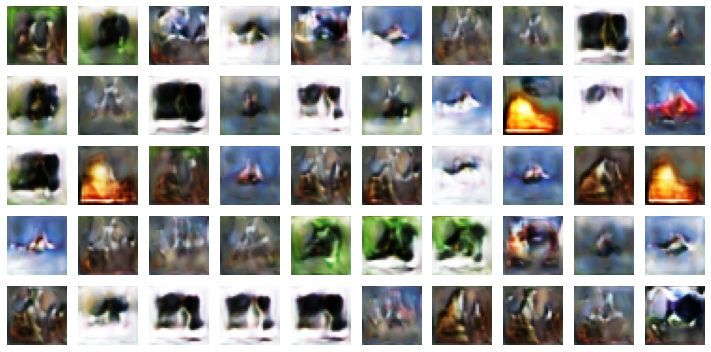

wandb: Adding directory to artifact (./Discriminator-Epoch6)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch6)... Done. 0.0s


391/391 [==============================] - 34s 88ms/step - d_loss: 0.6866 - g_loss: 0.7723 - val_kid: 0.0189
Epoch 8/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6865 - g_loss: 0.7726

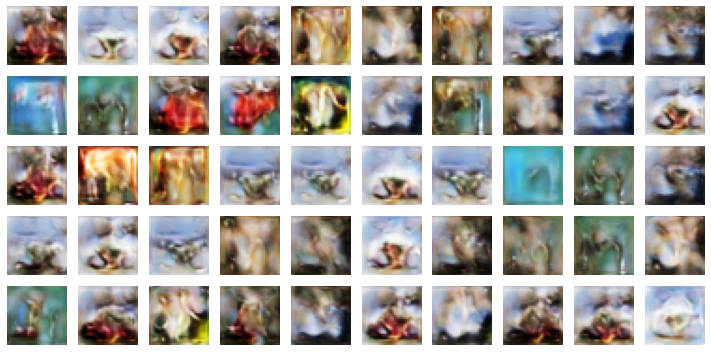

wandb: Adding directory to artifact (./Discriminator-Epoch7)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch7)... Done. 0.1s


391/391 [==============================] - 35s 89ms/step - d_loss: 0.6866 - g_loss: 0.7725 - val_kid: 0.0093
Epoch 9/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6861 - g_loss: 0.7684

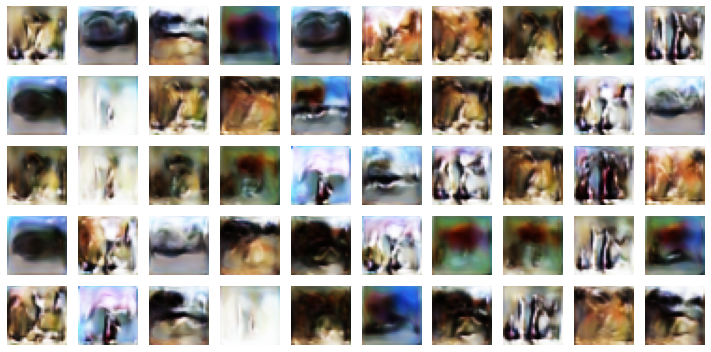

wandb: Adding directory to artifact (./Discriminator-Epoch8)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch8)... Done. 0.0s


391/391 [==============================] - 34s 88ms/step - d_loss: 0.6861 - g_loss: 0.7683 - val_kid: 0.0161
Epoch 10/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6856 - g_loss: 0.7708

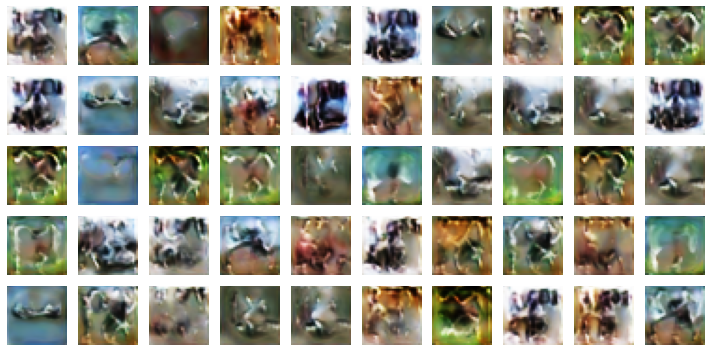

wandb: Adding directory to artifact (./Discriminator-Epoch9)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch9)... Done. 0.0s


391/391 [==============================] - 35s 89ms/step - d_loss: 0.6857 - g_loss: 0.7707 - val_kid: 0.0146
Epoch 11/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6870 - g_loss: 0.7725

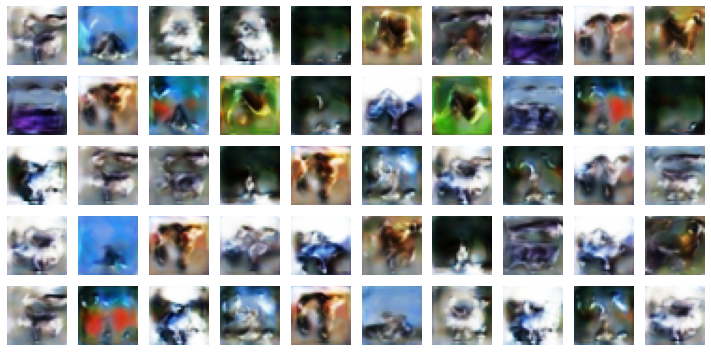

wandb: Adding directory to artifact (./Discriminator-Epoch10)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch10)... Done. 0.0s


391/391 [==============================] - 35s 89ms/step - d_loss: 0.6869 - g_loss: 0.7725 - val_kid: 0.0071
Epoch 12/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6855 - g_loss: 0.7723

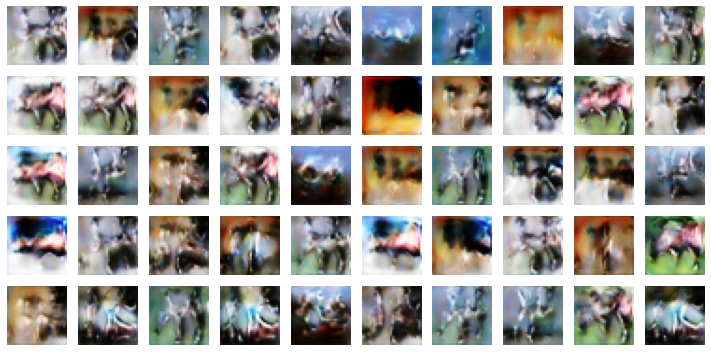

wandb: Adding directory to artifact (./Discriminator-Epoch11)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch11)... Done. 0.0s


391/391 [==============================] - 35s 89ms/step - d_loss: 0.6856 - g_loss: 0.7722 - val_kid: 0.0088
Epoch 13/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6831 - g_loss: 0.7743

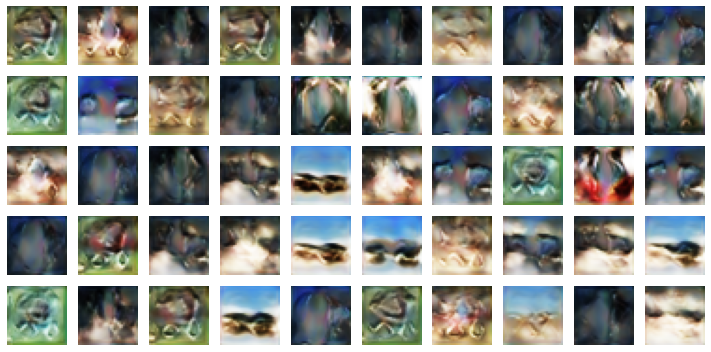

wandb: Adding directory to artifact (./Discriminator-Epoch12)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch12)... Done. 0.0s


391/391 [==============================] - 35s 89ms/step - d_loss: 0.6832 - g_loss: 0.7743 - val_kid: 0.0086
Epoch 14/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6824 - g_loss: 0.7766

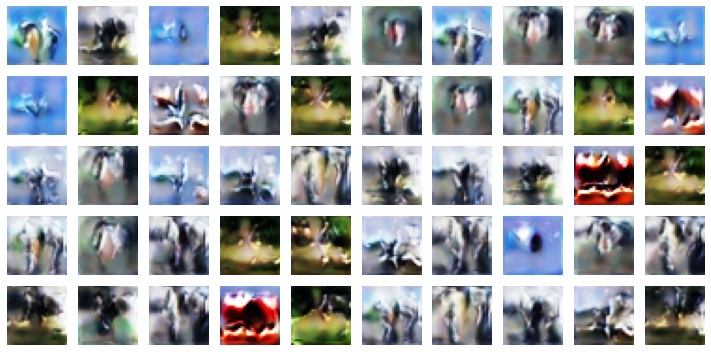

wandb: Adding directory to artifact (./Discriminator-Epoch13)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch13)... Done. 0.0s


391/391 [==============================] - 35s 89ms/step - d_loss: 0.6823 - g_loss: 0.7767 - val_kid: 0.0341
Epoch 15/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6826 - g_loss: 0.7772

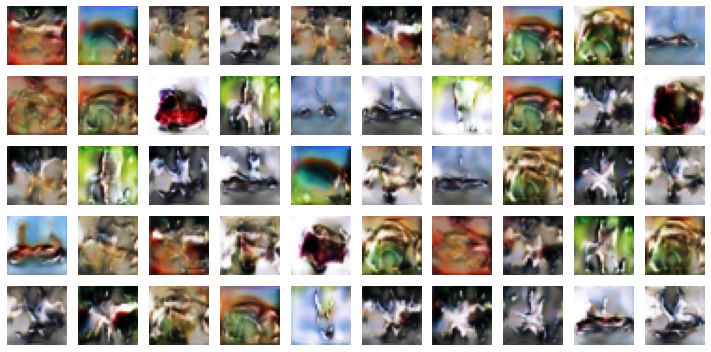

wandb: Adding directory to artifact (./Discriminator-Epoch14)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch14)... Done. 0.1s


391/391 [==============================] - 36s 93ms/step - d_loss: 0.6826 - g_loss: 0.7772 - val_kid: 0.0221
Epoch 16/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6852 - g_loss: 0.7739

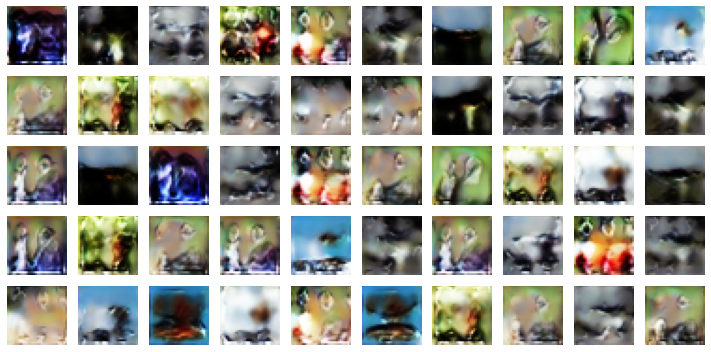

wandb: Adding directory to artifact (./Discriminator-Epoch15)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch15)... Done. 0.0s


391/391 [==============================] - 35s 90ms/step - d_loss: 0.6851 - g_loss: 0.7740 - val_kid: 0.0238
Epoch 17/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6825 - g_loss: 0.7758

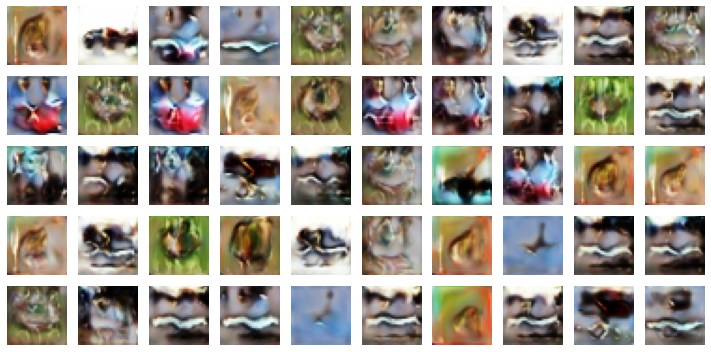

wandb: Adding directory to artifact (./Discriminator-Epoch16)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch16)... Done. 0.0s


391/391 [==============================] - 36s 92ms/step - d_loss: 0.6825 - g_loss: 0.7759 - val_kid: 0.0084
Epoch 18/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6824 - g_loss: 0.7762

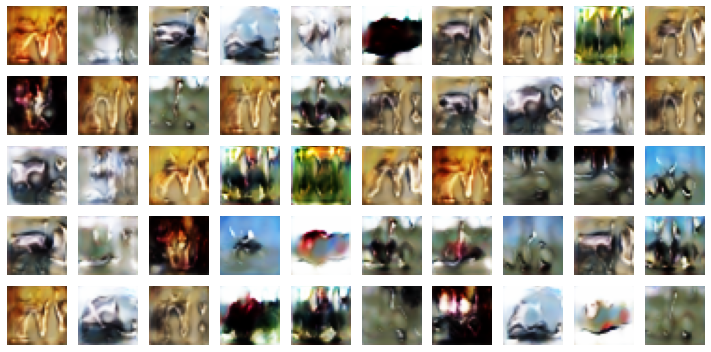

wandb: Adding directory to artifact (./Discriminator-Epoch17)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch17)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6825 - g_loss: 0.7764 - val_kid: 0.0138
Epoch 19/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6792 - g_loss: 0.7801

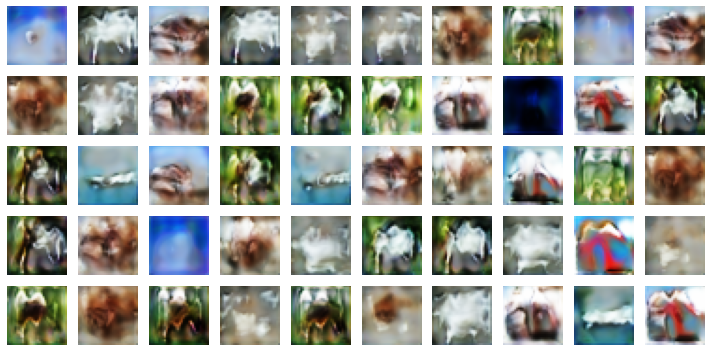

wandb: Adding directory to artifact (./Discriminator-Epoch18)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch18)... Done. 0.1s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6792 - g_loss: 0.7801 - val_kid: 0.0103
Epoch 20/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6808 - g_loss: 0.7788

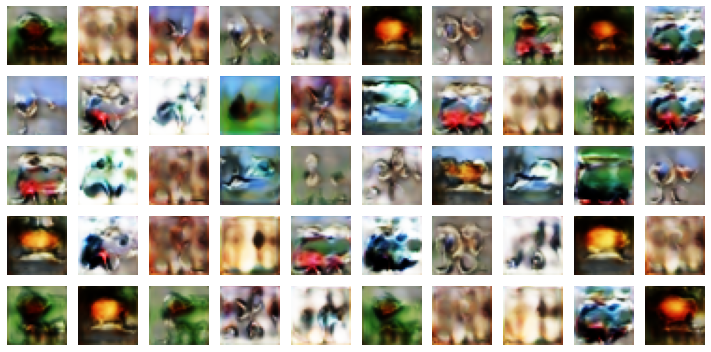

wandb: Adding directory to artifact (./Discriminator-Epoch19)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch19)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6807 - g_loss: 0.7789 - val_kid: 0.0066
Epoch 21/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6796 - g_loss: 0.7808

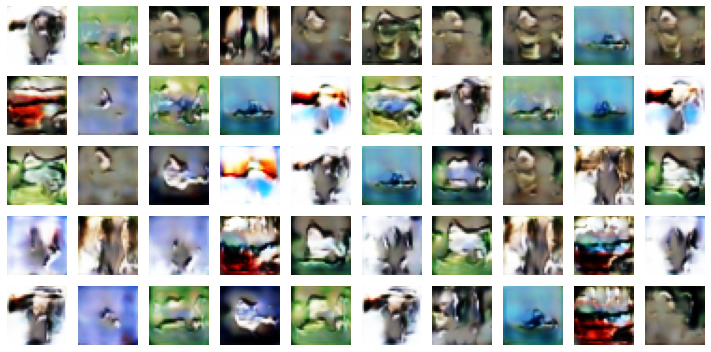

wandb: Adding directory to artifact (./Discriminator-Epoch20)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch20)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6796 - g_loss: 0.7809 - val_kid: 0.0313
Epoch 22/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6796 - g_loss: 0.7820

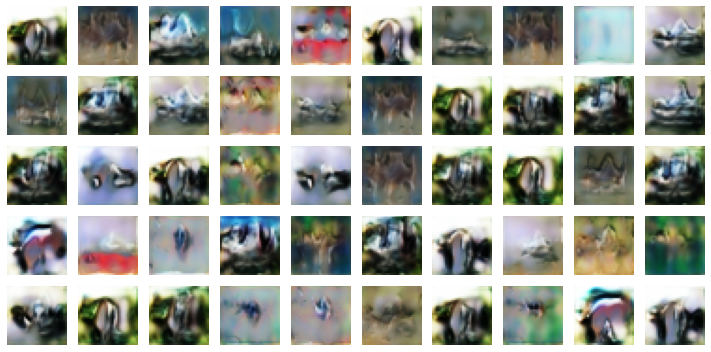

wandb: Adding directory to artifact (./Discriminator-Epoch21)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch21)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6796 - g_loss: 0.7819 - val_kid: 0.0136
Epoch 23/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6768 - g_loss: 0.7853

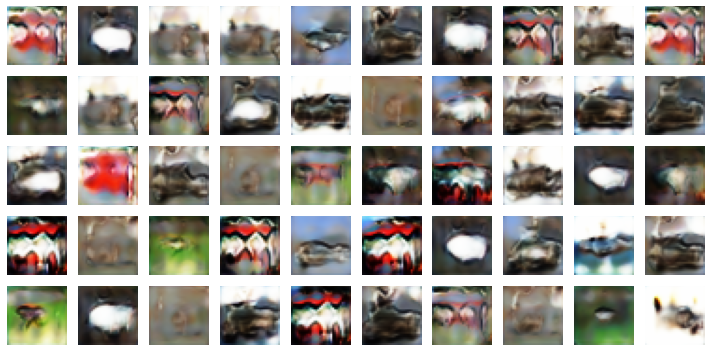

wandb: Adding directory to artifact (./Discriminator-Epoch22)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch22)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6768 - g_loss: 0.7853 - val_kid: 0.0164
Epoch 24/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6803 - g_loss: 0.7822

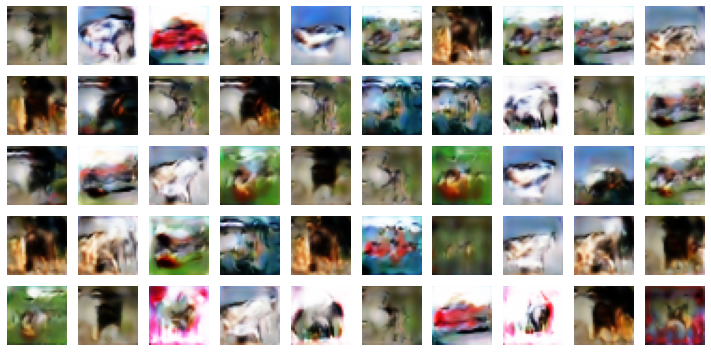

wandb: Adding directory to artifact (./Discriminator-Epoch23)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch23)... Done. 0.0s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6804 - g_loss: 0.7825 - val_kid: 0.0065
Epoch 25/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6796 - g_loss: 0.7800

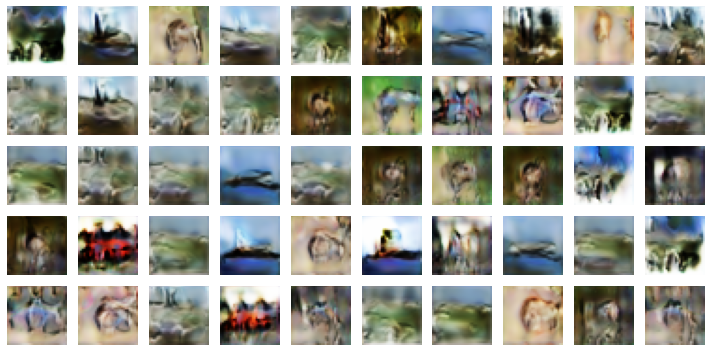

wandb: Adding directory to artifact (./Discriminator-Epoch24)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch24)... Done. 0.0s


391/391 [==============================] - 38s 98ms/step - d_loss: 0.6795 - g_loss: 0.7800 - val_kid: 0.0074
Epoch 26/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6786 - g_loss: 0.7815

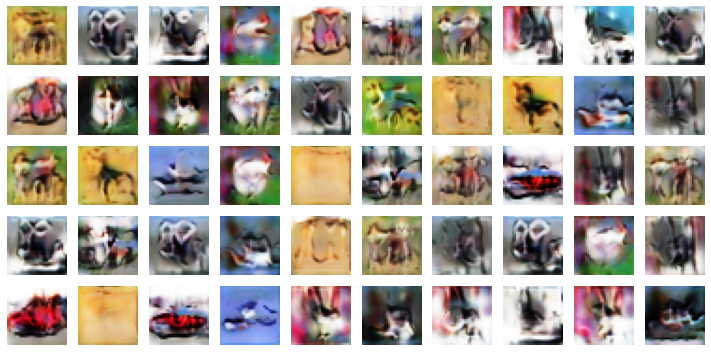

wandb: Adding directory to artifact (./Discriminator-Epoch25)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch25)... Done. 0.1s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6786 - g_loss: 0.7815 - val_kid: 0.0156
Epoch 27/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6766 - g_loss: 0.7819

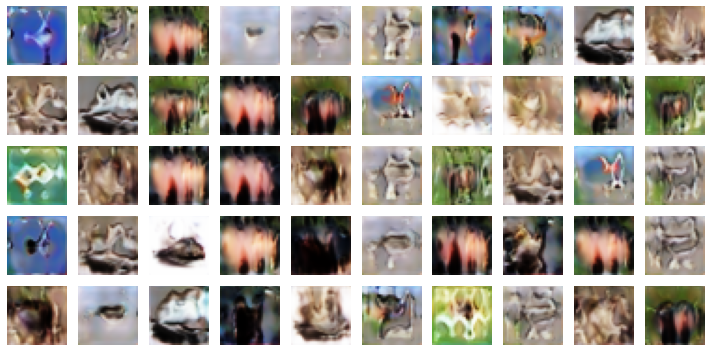

wandb: Adding directory to artifact (./Discriminator-Epoch26)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch26)... Done. 0.0s


391/391 [==============================] - 41s 106ms/step - d_loss: 0.6765 - g_loss: 0.7819 - val_kid: 0.0086
Epoch 28/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6776 - g_loss: 0.7827

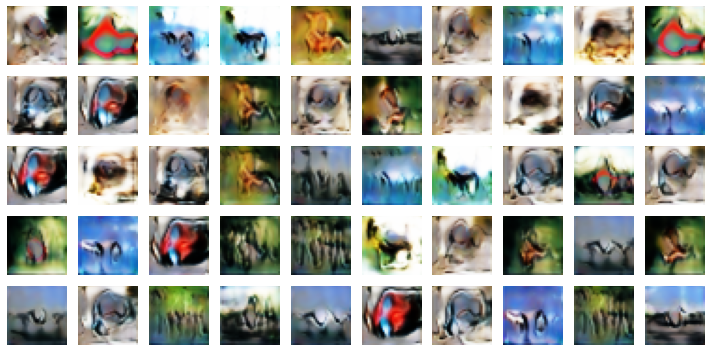

wandb: Adding directory to artifact (./Discriminator-Epoch27)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch27)... Done. 0.0s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6777 - g_loss: 0.7827 - val_kid: 0.0096
Epoch 29/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6736 - g_loss: 0.7913

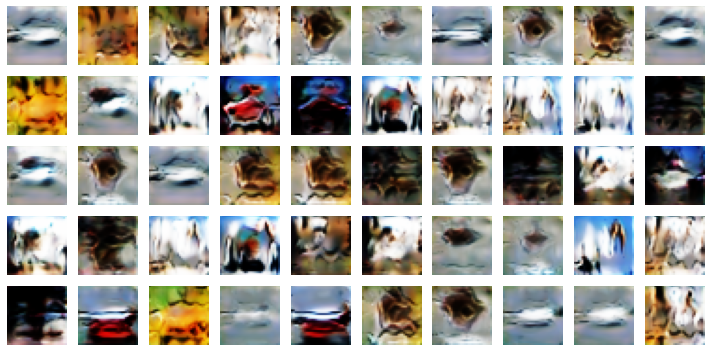

wandb: Adding directory to artifact (./Discriminator-Epoch28)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch28)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6736 - g_loss: 0.7914 - val_kid: 0.0230
Epoch 30/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6787 - g_loss: 0.7828

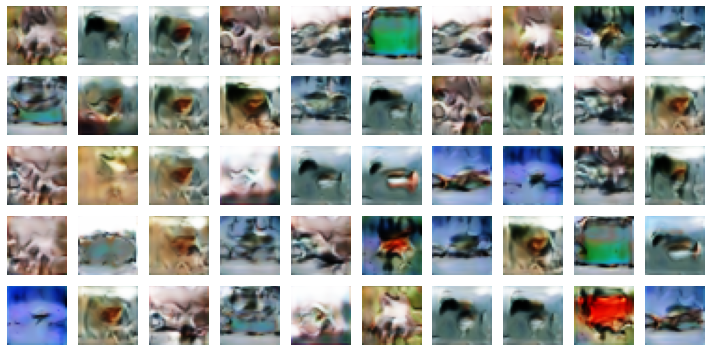

wandb: Adding directory to artifact (./Discriminator-Epoch29)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch29)... Done. 0.1s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6787 - g_loss: 0.7829 - val_kid: 0.0064
Epoch 31/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6770 - g_loss: 0.7875

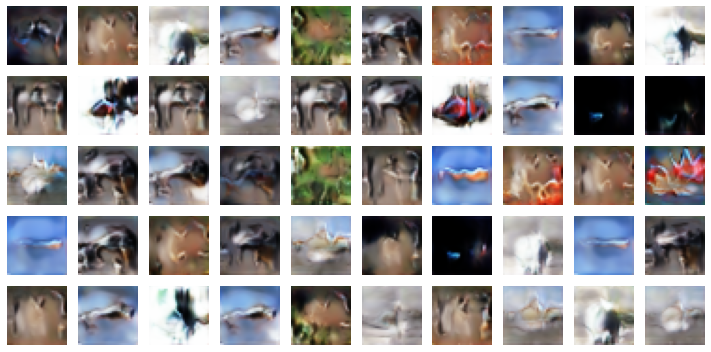

wandb: Adding directory to artifact (./Discriminator-Epoch30)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch30)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6770 - g_loss: 0.7874 - val_kid: 0.0108
Epoch 32/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6758 - g_loss: 0.7900

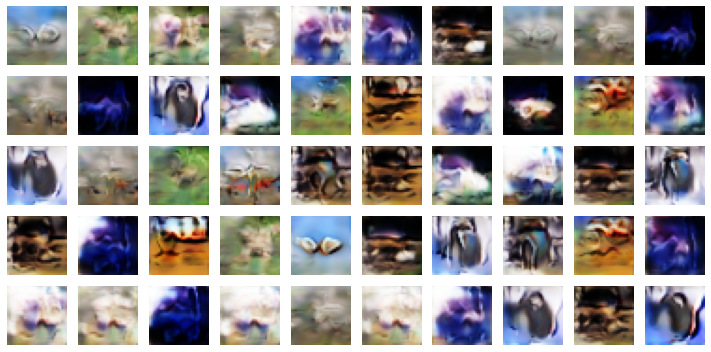

wandb: Adding directory to artifact (./Discriminator-Epoch31)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch31)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6758 - g_loss: 0.7900 - val_kid: 0.0111
Epoch 33/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6746 - g_loss: 0.7876

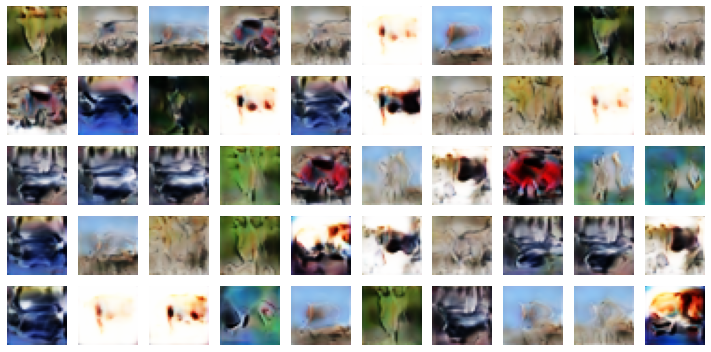

wandb: Adding directory to artifact (./Discriminator-Epoch32)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch32)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6747 - g_loss: 0.7877 - val_kid: 0.0041
Epoch 34/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6717 - g_loss: 0.7911

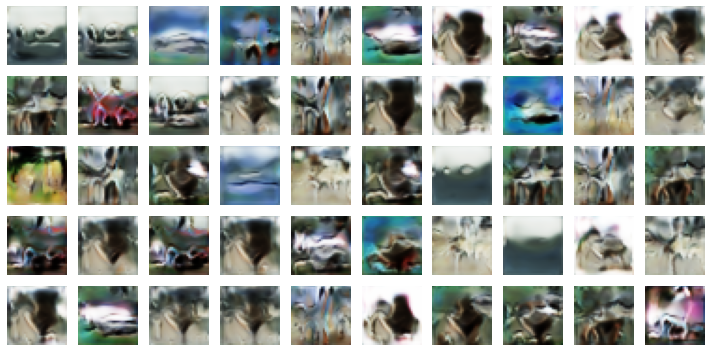

wandb: Adding directory to artifact (./Discriminator-Epoch33)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch33)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6718 - g_loss: 0.7909 - val_kid: 0.0119
Epoch 35/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6714 - g_loss: 0.7978

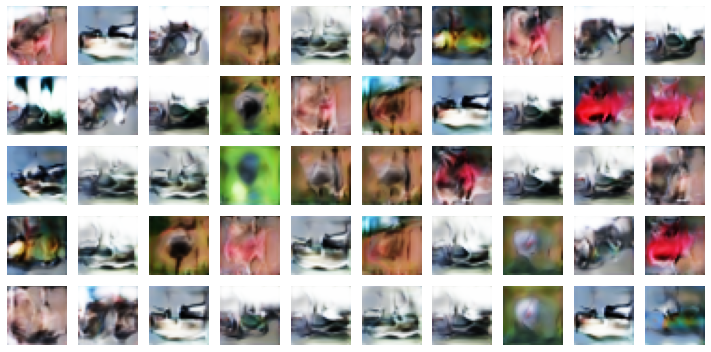

wandb: Adding directory to artifact (./Discriminator-Epoch34)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch34)... Done. 0.0s


391/391 [==============================] - 38s 98ms/step - d_loss: 0.6713 - g_loss: 0.7982 - val_kid: 0.0046
Epoch 36/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6698 - g_loss: 0.7970

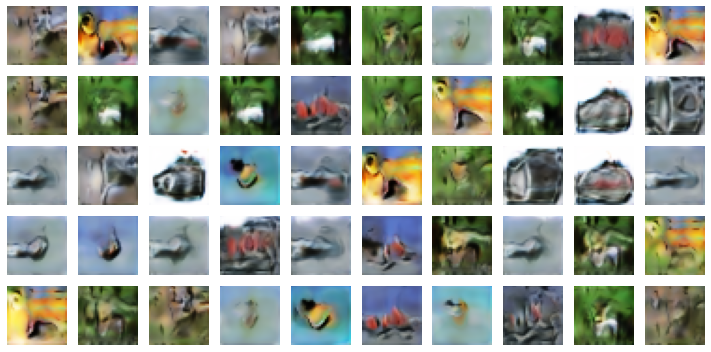

wandb: Adding directory to artifact (./Discriminator-Epoch35)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch35)... Done. 0.0s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6696 - g_loss: 0.7968 - val_kid: 0.0065
Epoch 37/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6701 - g_loss: 0.7969

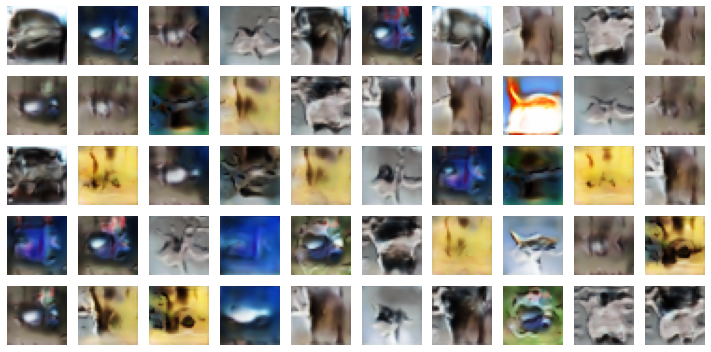

wandb: Adding directory to artifact (./Discriminator-Epoch36)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch36)... Done. 0.0s


391/391 [==============================] - 39s 100ms/step - d_loss: 0.6702 - g_loss: 0.7970 - val_kid: 0.0105
Epoch 38/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6696 - g_loss: 0.7965

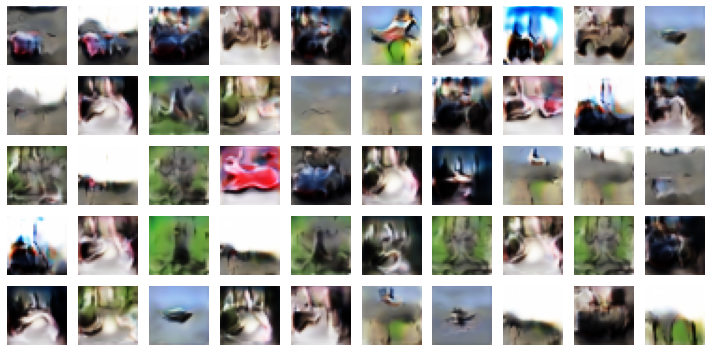

wandb: Adding directory to artifact (./Discriminator-Epoch37)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch37)... Done. 0.0s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6697 - g_loss: 0.7965 - val_kid: 0.0115
Epoch 39/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6706 - g_loss: 0.7964

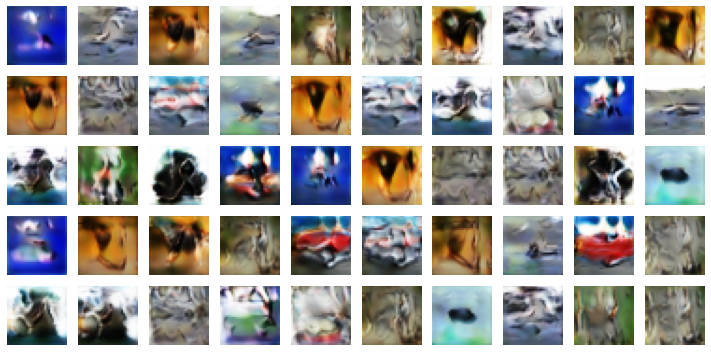

wandb: Adding directory to artifact (./Discriminator-Epoch38)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch38)... Done. 0.1s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6706 - g_loss: 0.7968 - val_kid: 0.0110
Epoch 40/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6670 - g_loss: 0.7998

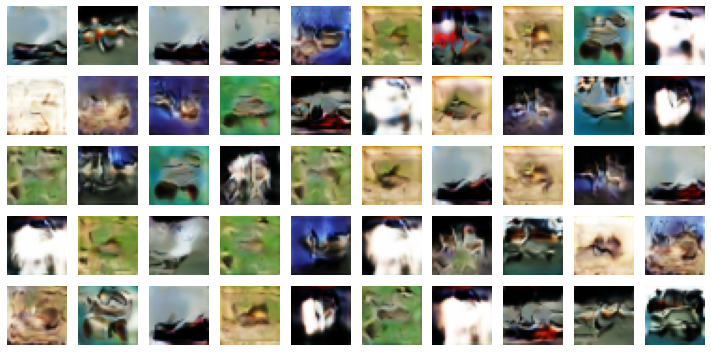

wandb: Adding directory to artifact (./Discriminator-Epoch39)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch39)... Done. 0.1s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6671 - g_loss: 0.7998 - val_kid: 0.0032
Epoch 41/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6667 - g_loss: 0.8003

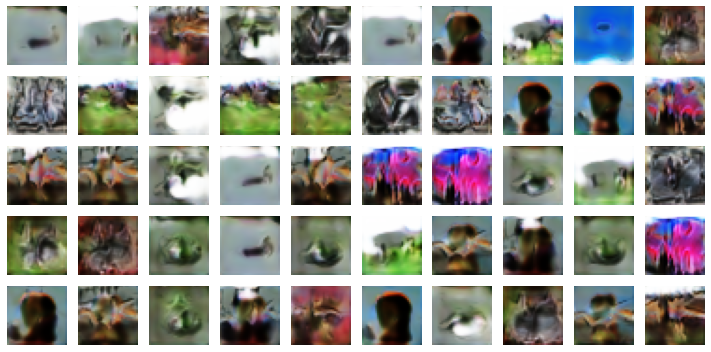

wandb: Adding directory to artifact (./Discriminator-Epoch40)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch40)... Done. 0.0s


391/391 [==============================] - 38s 98ms/step - d_loss: 0.6666 - g_loss: 0.8003 - val_kid: 0.0058
Epoch 42/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6683 - g_loss: 0.8025

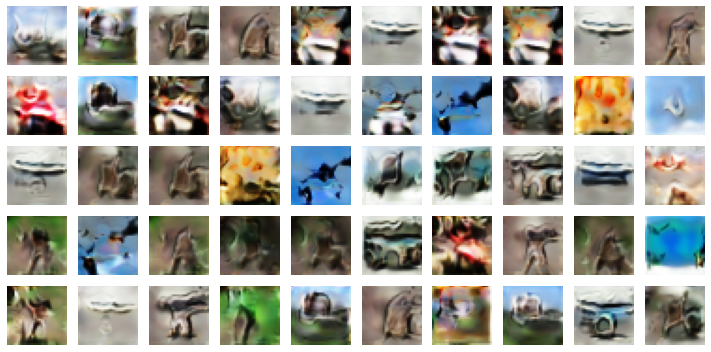

wandb: Adding directory to artifact (./Discriminator-Epoch41)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch41)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6683 - g_loss: 0.8025 - val_kid: 0.0179
Epoch 43/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6652 - g_loss: 0.8051

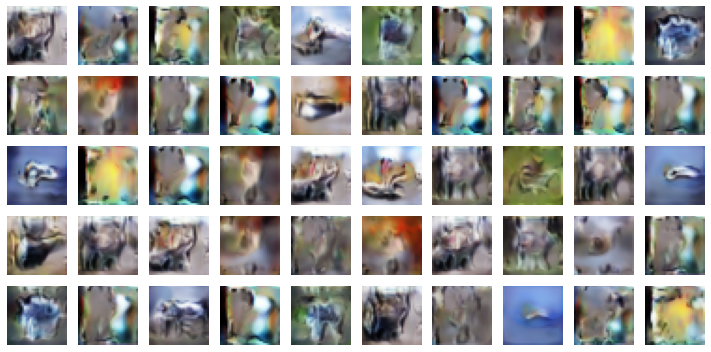

wandb: Adding directory to artifact (./Discriminator-Epoch42)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch42)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6650 - g_loss: 0.8051 - val_kid: 0.0088
Epoch 44/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6697 - g_loss: 0.7965

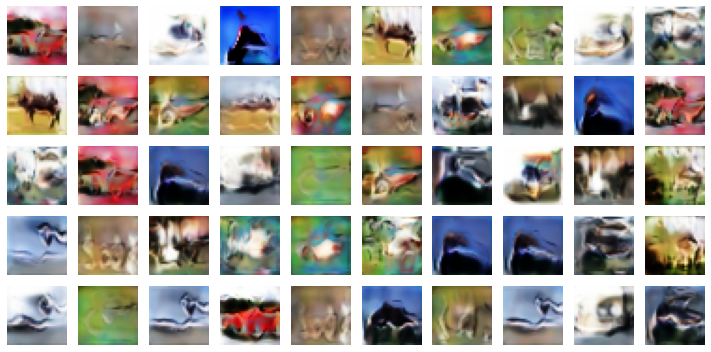

wandb: Adding directory to artifact (./Discriminator-Epoch43)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch43)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6696 - g_loss: 0.7964 - val_kid: 0.0048
Epoch 45/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6680 - g_loss: 0.8040

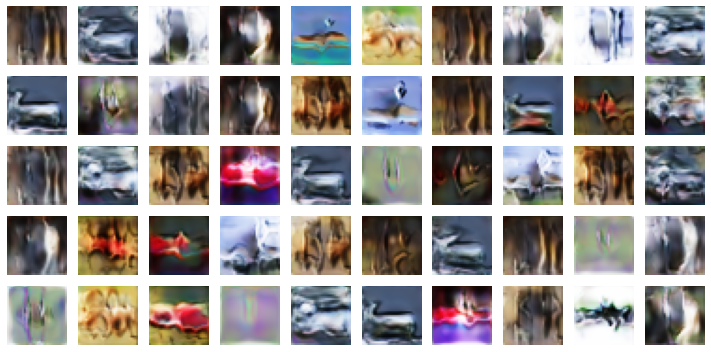

wandb: Adding directory to artifact (./Discriminator-Epoch44)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch44)... Done. 0.1s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6680 - g_loss: 0.8039 - val_kid: 0.0069
Epoch 46/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6580 - g_loss: 0.8130

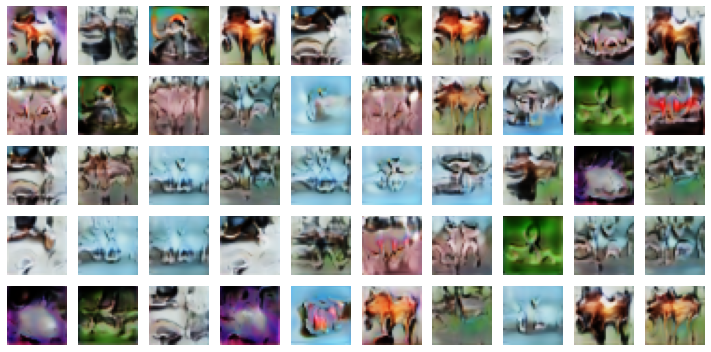

wandb: Adding directory to artifact (./Discriminator-Epoch45)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch45)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6581 - g_loss: 0.8129 - val_kid: 0.0155
Epoch 47/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6641 - g_loss: 0.8092

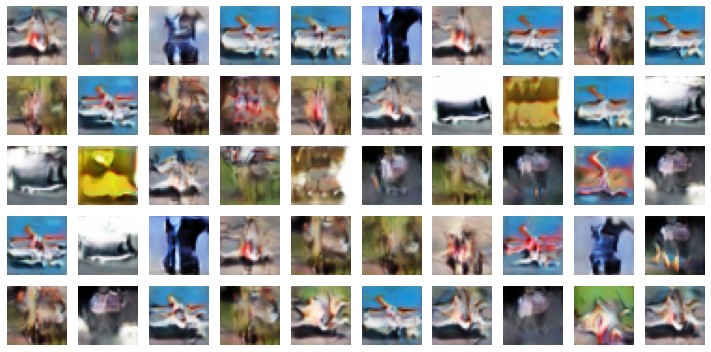

wandb: Adding directory to artifact (./Discriminator-Epoch46)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch46)... Done. 0.1s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6641 - g_loss: 0.8094 - val_kid: 0.0123
Epoch 48/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6646 - g_loss: 0.8115

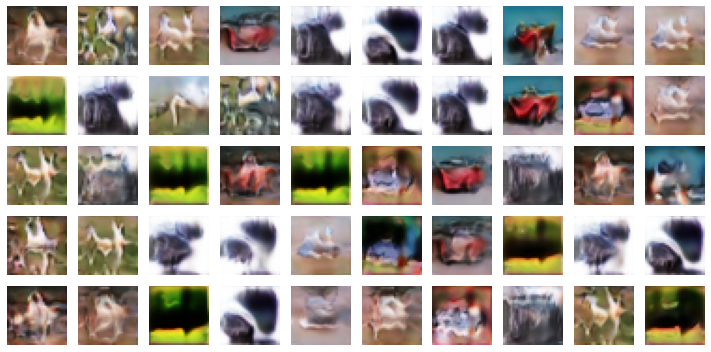

wandb: Adding directory to artifact (./Discriminator-Epoch47)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch47)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6646 - g_loss: 0.8118 - val_kid: 0.0133
Epoch 49/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6558 - g_loss: 0.8254

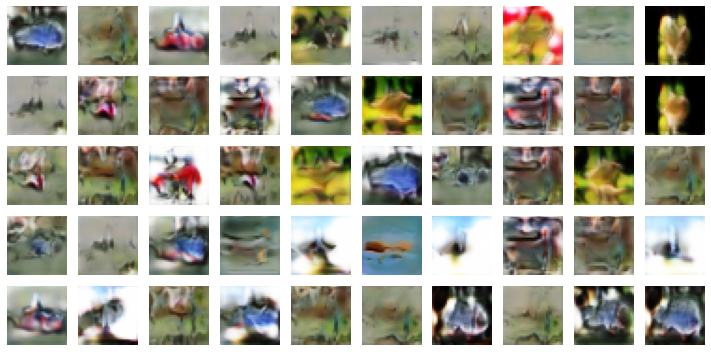

wandb: Adding directory to artifact (./Discriminator-Epoch48)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch48)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6559 - g_loss: 0.8252 - val_kid: 0.0143
Epoch 50/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6537 - g_loss: 0.8228

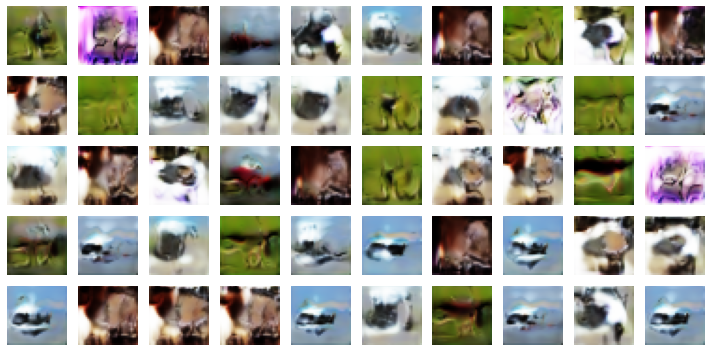

wandb: Adding directory to artifact (./Discriminator-Epoch49)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch49)... Done. 0.1s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6538 - g_loss: 0.8228 - val_kid: 0.0070
Epoch 51/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6534 - g_loss: 0.8308

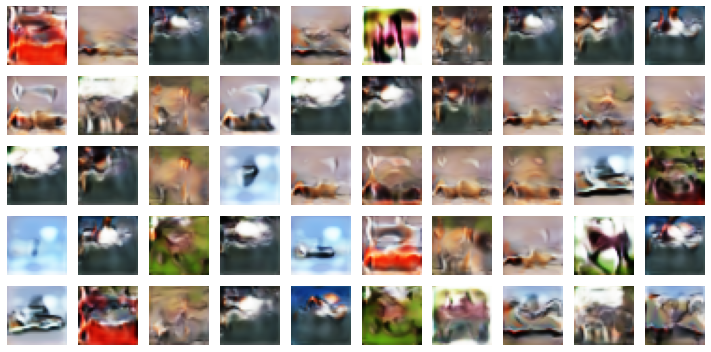

wandb: Adding directory to artifact (./Discriminator-Epoch50)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch50)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6536 - g_loss: 0.8309 - val_kid: 0.0055
Epoch 52/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6561 - g_loss: 0.8326

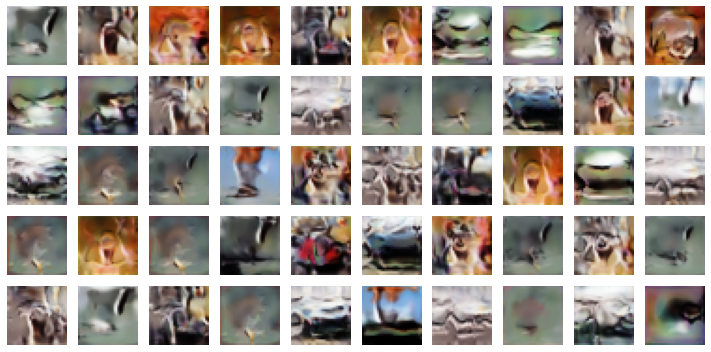

wandb: Adding directory to artifact (./Discriminator-Epoch51)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch51)... Done. 0.1s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6562 - g_loss: 0.8329 - val_kid: 0.0178
Epoch 53/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6557 - g_loss: 0.8207

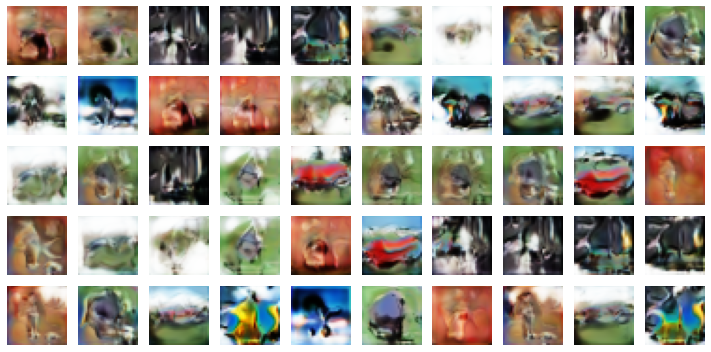

wandb: Adding directory to artifact (./Discriminator-Epoch52)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch52)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6555 - g_loss: 0.8209 - val_kid: 0.0070
Epoch 54/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6575 - g_loss: 0.8202

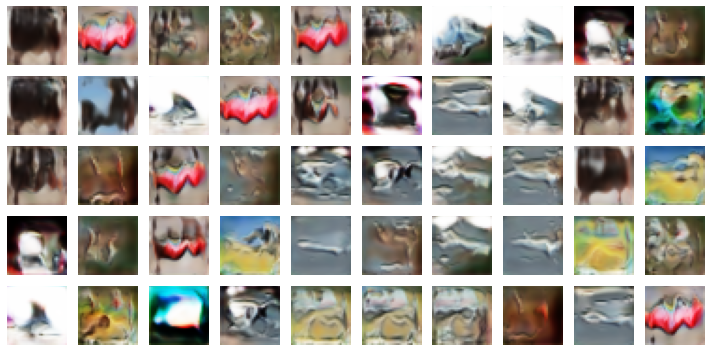

wandb: Adding directory to artifact (./Discriminator-Epoch53)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch53)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6574 - g_loss: 0.8205 - val_kid: 0.0086
Epoch 55/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6577 - g_loss: 0.8200

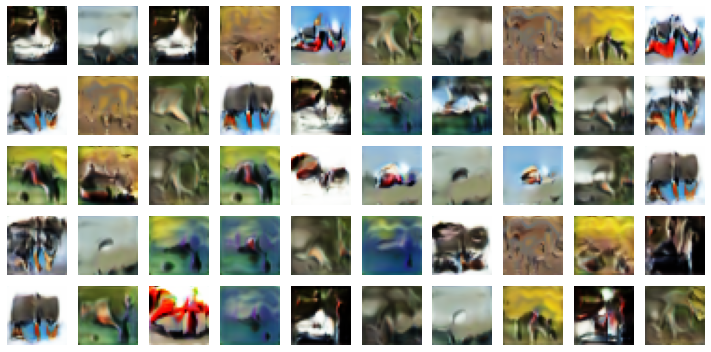

wandb: Adding directory to artifact (./Discriminator-Epoch54)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch54)... Done. 0.1s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6579 - g_loss: 0.8200 - val_kid: 0.0074
Epoch 56/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6572 - g_loss: 0.8225

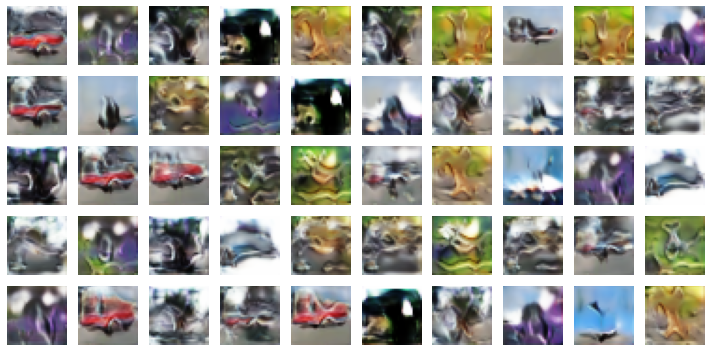

wandb: Adding directory to artifact (./Discriminator-Epoch55)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch55)... Done. 0.1s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6573 - g_loss: 0.8227 - val_kid: 0.0077
Epoch 57/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6578 - g_loss: 0.8202

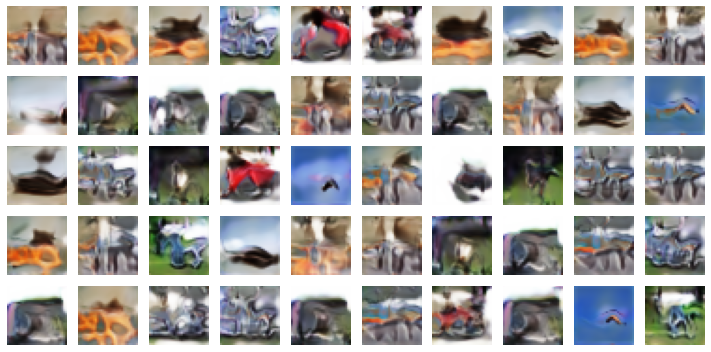

wandb: Adding directory to artifact (./Discriminator-Epoch56)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch56)... Done. 0.1s


391/391 [==============================] - 39s 99ms/step - d_loss: 0.6578 - g_loss: 0.8206 - val_kid: 0.0080
Epoch 58/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6531 - g_loss: 0.8318

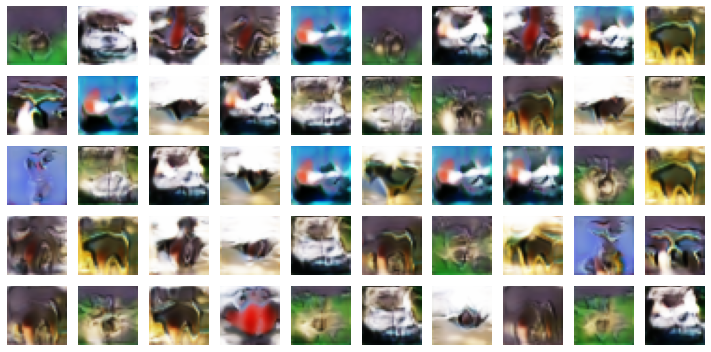

wandb: Adding directory to artifact (./Discriminator-Epoch57)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch57)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6531 - g_loss: 0.8319 - val_kid: 0.0043
Epoch 59/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6552 - g_loss: 0.8254

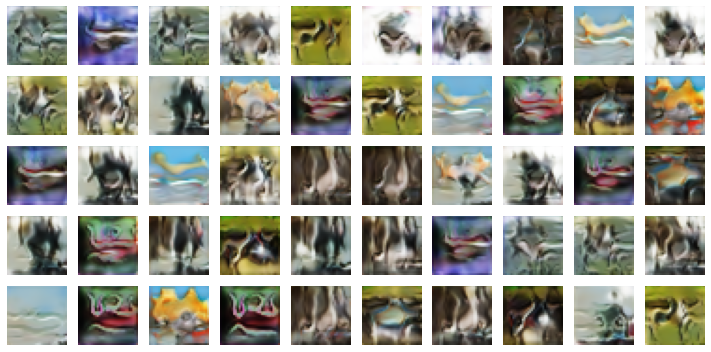

wandb: Adding directory to artifact (./Discriminator-Epoch58)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch58)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6551 - g_loss: 0.8256 - val_kid: 0.0113
Epoch 60/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6480 - g_loss: 0.8507

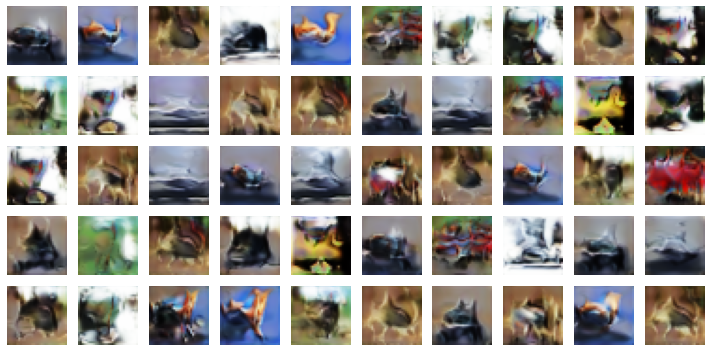

wandb: Adding directory to artifact (./Discriminator-Epoch59)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch59)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6482 - g_loss: 0.8506 - val_kid: 0.0090
Epoch 61/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6480 - g_loss: 0.8387

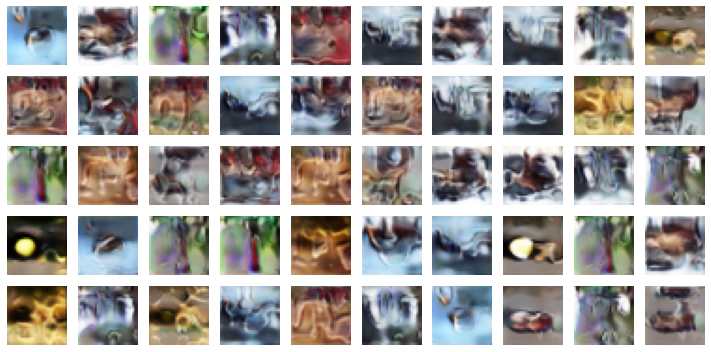

wandb: Adding directory to artifact (./Discriminator-Epoch60)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch60)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6480 - g_loss: 0.8389 - val_kid: 0.0119
Epoch 62/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6458 - g_loss: 0.8425

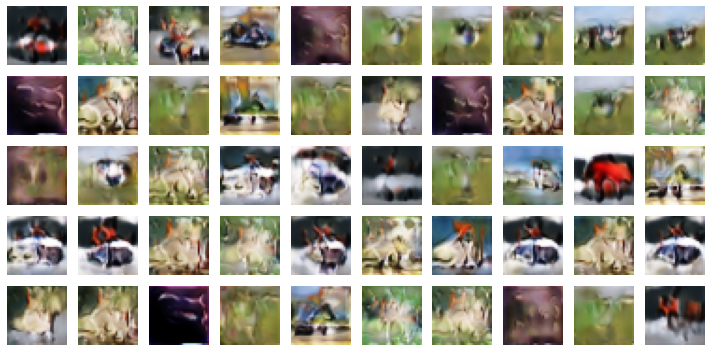

wandb: Adding directory to artifact (./Discriminator-Epoch61)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch61)... Done. 0.1s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6459 - g_loss: 0.8426 - val_kid: 0.0063
Epoch 63/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6498 - g_loss: 0.8369

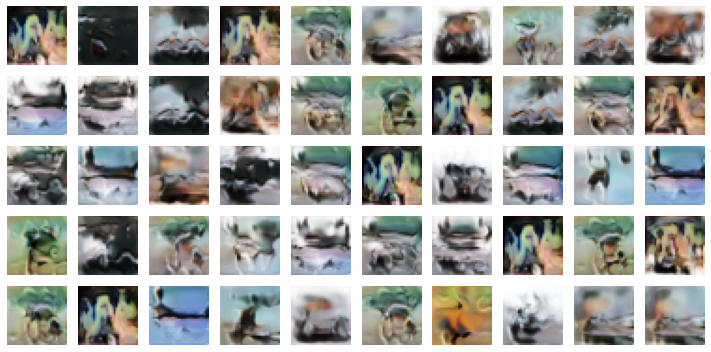

wandb: Adding directory to artifact (./Discriminator-Epoch62)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch62)... Done. 0.1s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6499 - g_loss: 0.8369 - val_kid: 0.0085
Epoch 64/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6596 - g_loss: 0.8299

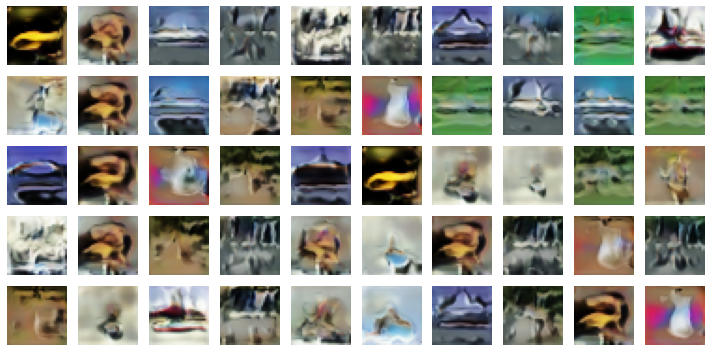

wandb: Adding directory to artifact (./Discriminator-Epoch63)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch63)... Done. 0.1s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6595 - g_loss: 0.8301 - val_kid: 0.0097
Epoch 65/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6542 - g_loss: 0.8264

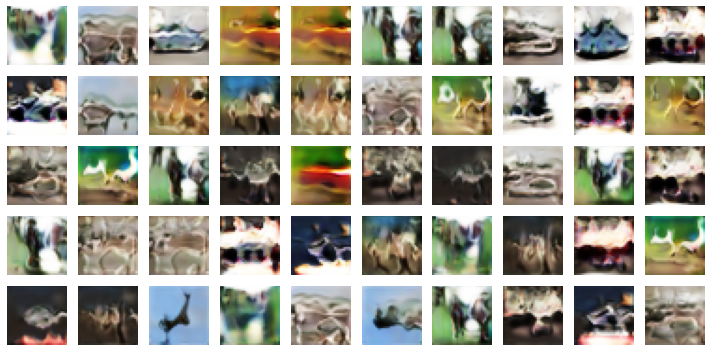

wandb: Adding directory to artifact (./Discriminator-Epoch64)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch64)... Done. 0.0s


391/391 [==============================] - 37s 94ms/step - d_loss: 0.6540 - g_loss: 0.8267 - val_kid: 0.0142
Epoch 66/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6464 - g_loss: 0.8382

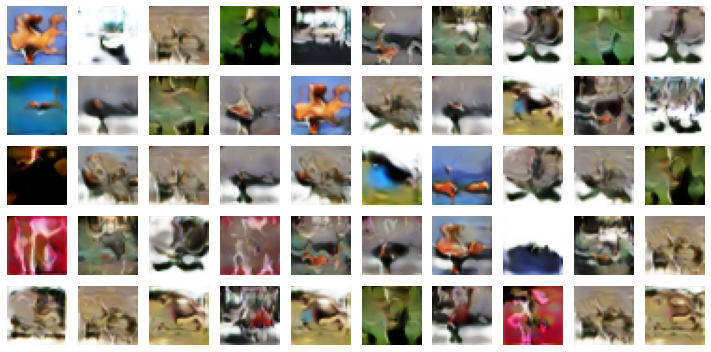

wandb: Adding directory to artifact (./Discriminator-Epoch65)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch65)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6465 - g_loss: 0.8381 - val_kid: 0.0093
Epoch 67/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6541 - g_loss: 0.8407

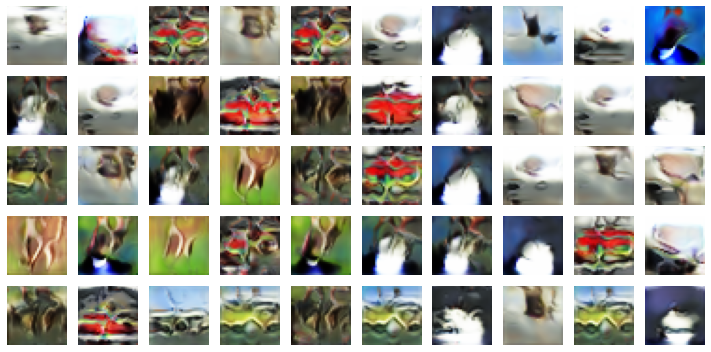

wandb: Adding directory to artifact (./Discriminator-Epoch66)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch66)... Done. 0.1s


391/391 [==============================] - 38s 98ms/step - d_loss: 0.6541 - g_loss: 0.8406 - val_kid: 0.0114
Epoch 68/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6443 - g_loss: 0.8488

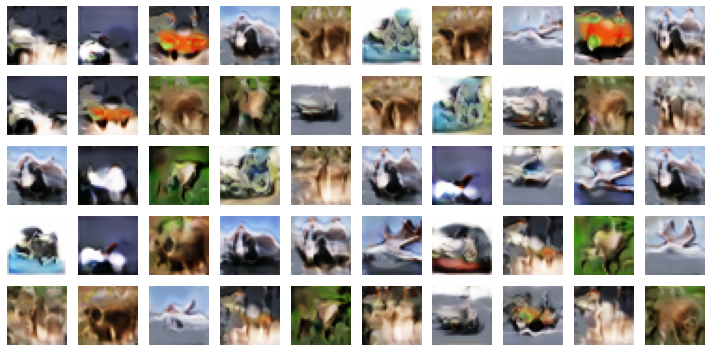

wandb: Adding directory to artifact (./Discriminator-Epoch67)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch67)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6443 - g_loss: 0.8493 - val_kid: 0.0063
Epoch 69/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6332 - g_loss: 0.8637

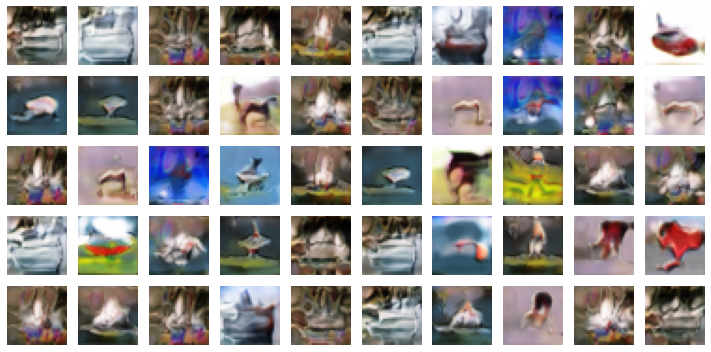

wandb: Adding directory to artifact (./Discriminator-Epoch68)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch68)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6331 - g_loss: 0.8633 - val_kid: 0.0122
Epoch 70/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6423 - g_loss: 0.8556

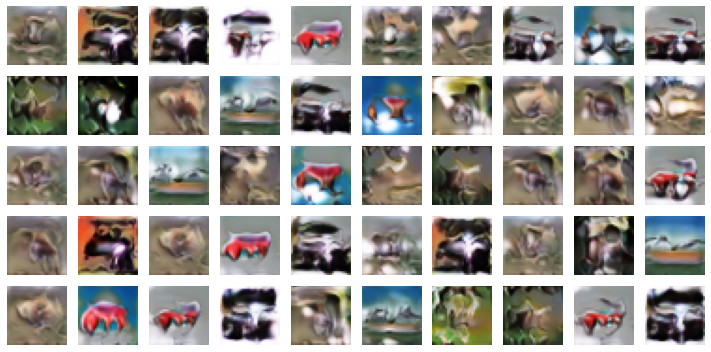

wandb: Adding directory to artifact (./Discriminator-Epoch69)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch69)... Done. 0.1s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6425 - g_loss: 0.8557 - val_kid: 0.0056
Epoch 71/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6389 - g_loss: 0.8585

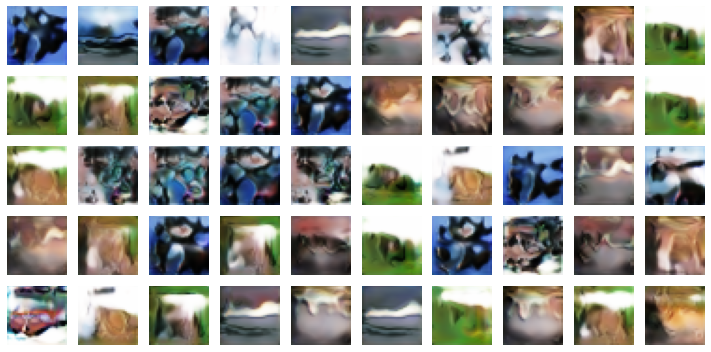

wandb: Adding directory to artifact (./Discriminator-Epoch70)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch70)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6390 - g_loss: 0.8580 - val_kid: 0.0076
Epoch 72/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6375 - g_loss: 0.8569

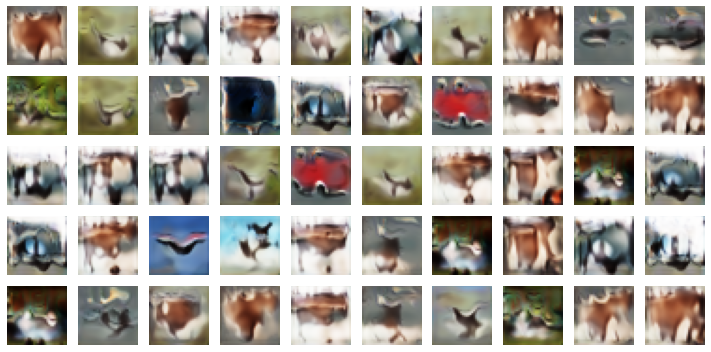

wandb: Adding directory to artifact (./Discriminator-Epoch71)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch71)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6377 - g_loss: 0.8566 - val_kid: 0.0112
Epoch 73/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6357 - g_loss: 0.8688

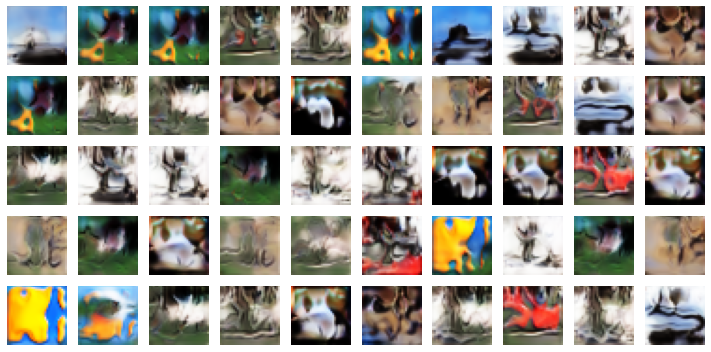

wandb: Adding directory to artifact (./Discriminator-Epoch72)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch72)... Done. 0.1s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6354 - g_loss: 0.8688 - val_kid: 0.0236
Epoch 74/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6347 - g_loss: 0.8692

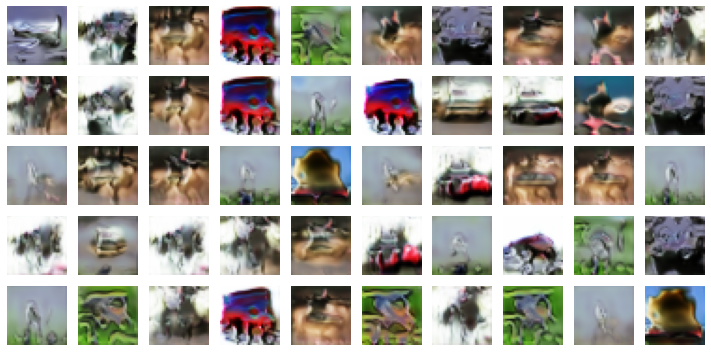

wandb: Adding directory to artifact (./Discriminator-Epoch73)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch73)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6347 - g_loss: 0.8692 - val_kid: 0.0045
Epoch 75/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6384 - g_loss: 0.8618

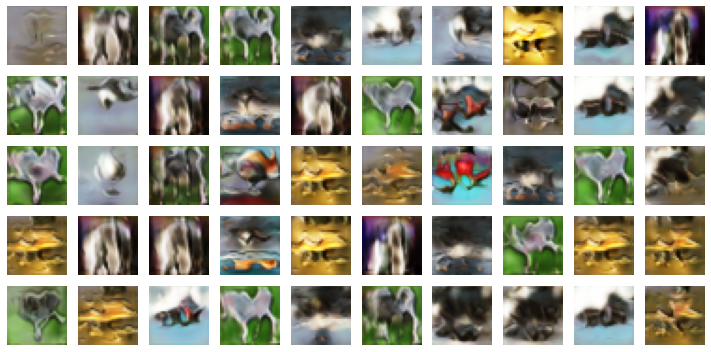

wandb: Adding directory to artifact (./Discriminator-Epoch74)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch74)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6388 - g_loss: 0.8618 - val_kid: 0.0108
Epoch 76/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6311 - g_loss: 0.8724

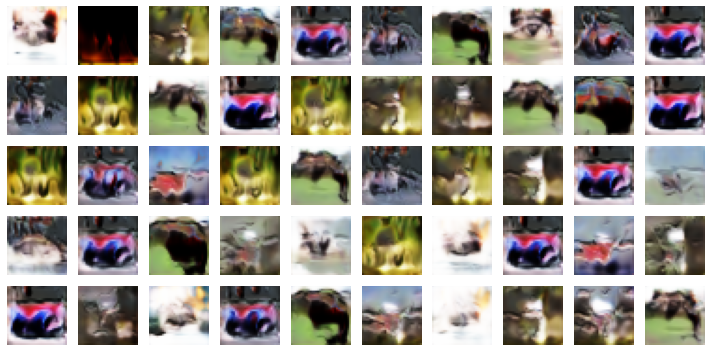

wandb: Adding directory to artifact (./Discriminator-Epoch75)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch75)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6312 - g_loss: 0.8723 - val_kid: 0.0083
Epoch 77/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6245 - g_loss: 0.8932

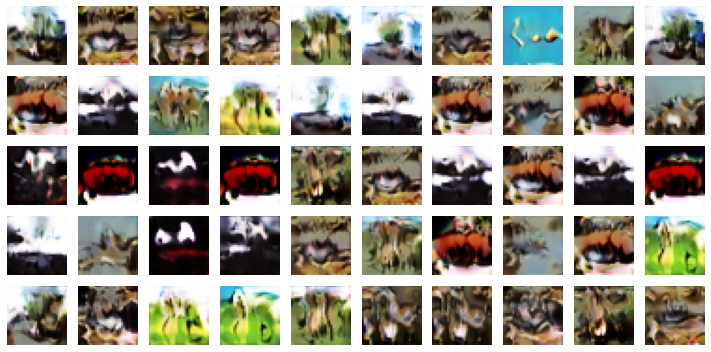

wandb: Adding directory to artifact (./Discriminator-Epoch76)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch76)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6243 - g_loss: 0.8932 - val_kid: 0.0479
Epoch 78/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6242 - g_loss: 0.8907

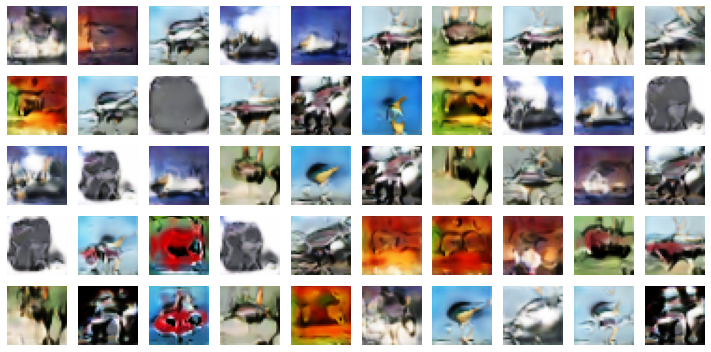

wandb: Adding directory to artifact (./Discriminator-Epoch77)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch77)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6243 - g_loss: 0.8910 - val_kid: 0.0370
Epoch 79/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6265 - g_loss: 0.8891

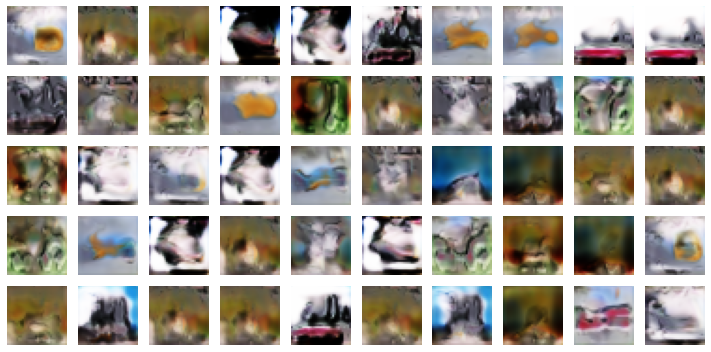

wandb: Adding directory to artifact (./Discriminator-Epoch78)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch78)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6264 - g_loss: 0.8904 - val_kid: 0.0224
Epoch 80/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6198 - g_loss: 0.8954

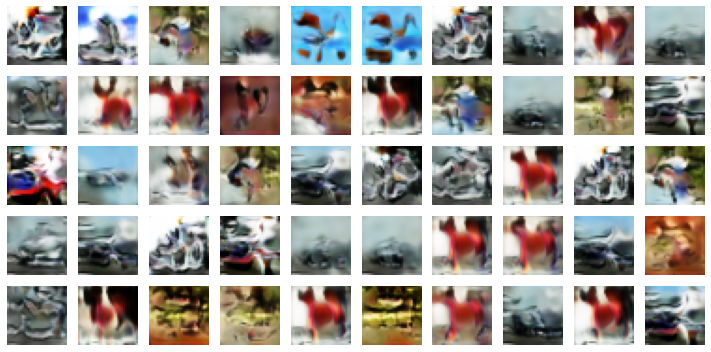

wandb: Adding directory to artifact (./Discriminator-Epoch79)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch79)... Done. 0.1s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6197 - g_loss: 0.8958 - val_kid: 0.0110
Epoch 81/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6141 - g_loss: 0.9036

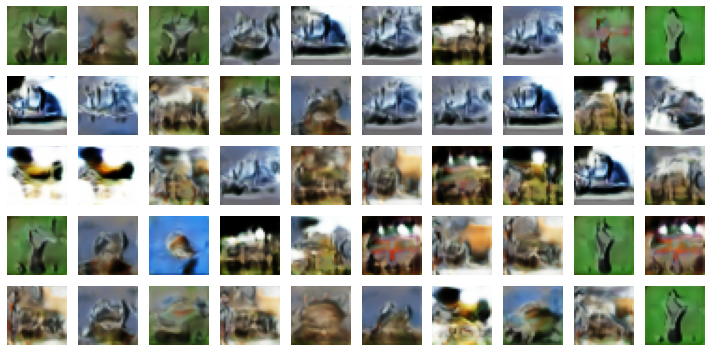

wandb: Adding directory to artifact (./Discriminator-Epoch80)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch80)... Done. 0.1s


391/391 [==============================] - 38s 98ms/step - d_loss: 0.6143 - g_loss: 0.9035 - val_kid: 0.0103
Epoch 82/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6219 - g_loss: 0.9049

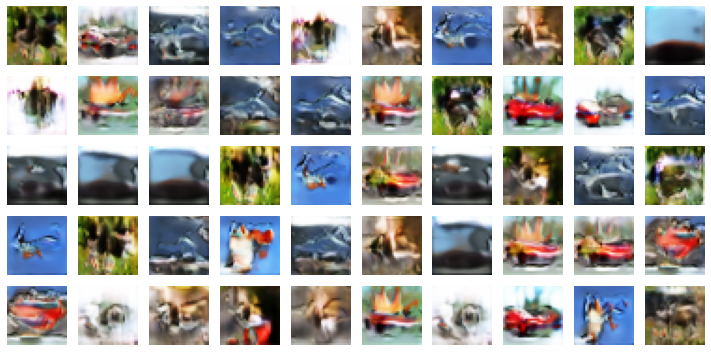

wandb: Adding directory to artifact (./Discriminator-Epoch81)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch81)... Done. 0.0s


391/391 [==============================] - 37s 96ms/step - d_loss: 0.6219 - g_loss: 0.9055 - val_kid: 0.0125
Epoch 83/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6152 - g_loss: 0.9100

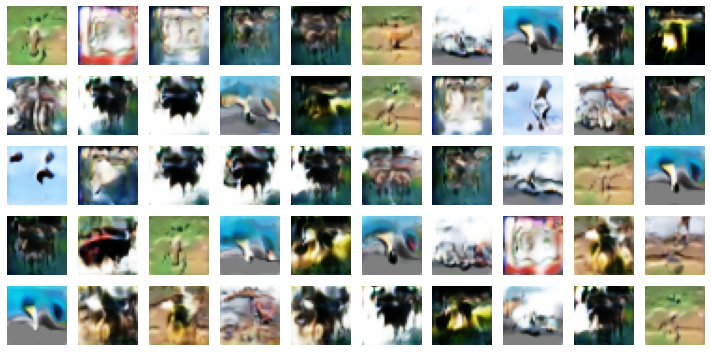

wandb: Adding directory to artifact (./Discriminator-Epoch82)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch82)... Done. 0.1s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6152 - g_loss: 0.9100 - val_kid: 0.0231
Epoch 84/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6330 - g_loss: 0.8817

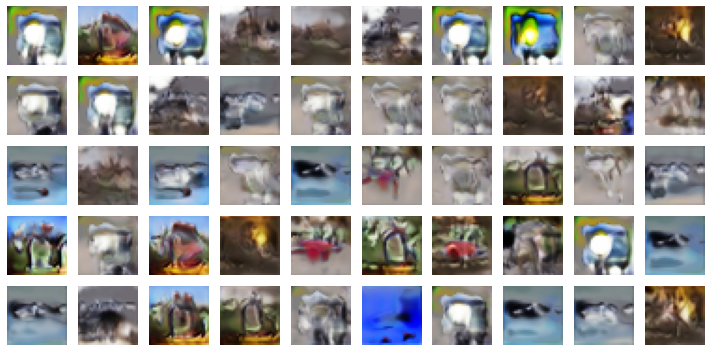

wandb: Adding directory to artifact (./Discriminator-Epoch83)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch83)... Done. 0.1s


391/391 [==============================] - 38s 98ms/step - d_loss: 0.6327 - g_loss: 0.8814 - val_kid: 0.0094
Epoch 85/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6239 - g_loss: 0.8959

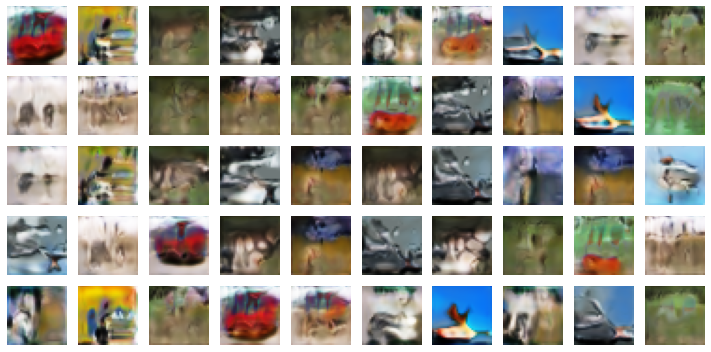

wandb: Adding directory to artifact (./Discriminator-Epoch84)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch84)... Done. 0.0s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6241 - g_loss: 0.8963 - val_kid: 0.0115
Epoch 86/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6306 - g_loss: 0.8871

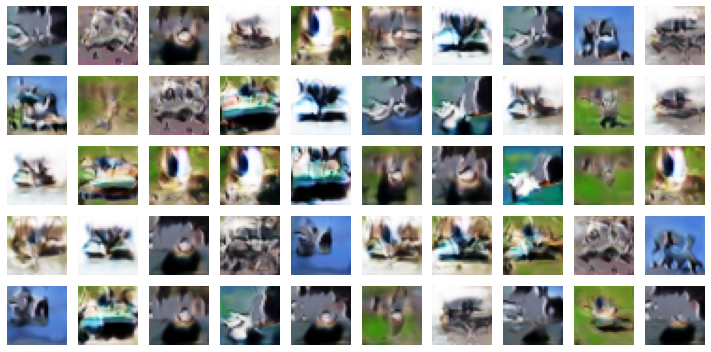

wandb: Adding directory to artifact (./Discriminator-Epoch85)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch85)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6301 - g_loss: 0.8875 - val_kid: 0.0161
Epoch 87/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6227 - g_loss: 0.8951

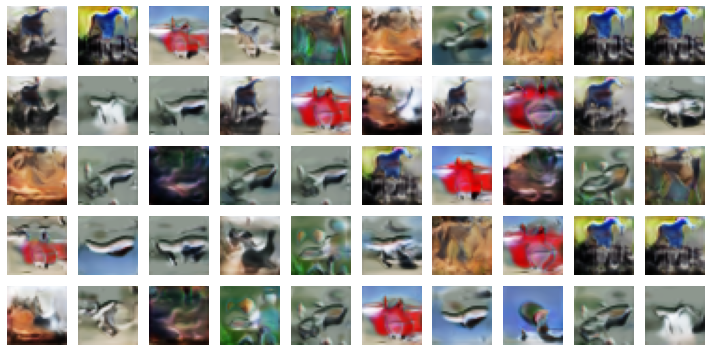

wandb: Adding directory to artifact (./Discriminator-Epoch86)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch86)... Done. 0.0s


391/391 [==============================] - 37s 94ms/step - d_loss: 0.6223 - g_loss: 0.8948 - val_kid: 0.0094
Epoch 88/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6255 - g_loss: 0.8913

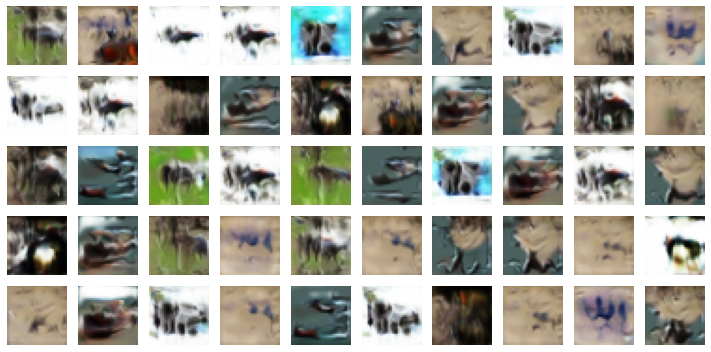

wandb: Adding directory to artifact (./Discriminator-Epoch87)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch87)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6252 - g_loss: 0.8918 - val_kid: 0.0080
Epoch 89/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6201 - g_loss: 0.9017

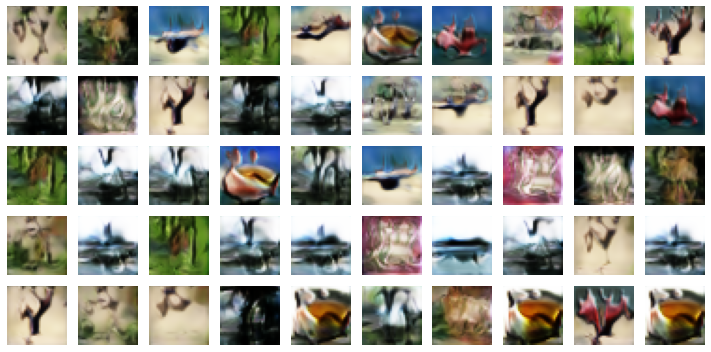

wandb: Adding directory to artifact (./Discriminator-Epoch88)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch88)... Done. 0.0s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6201 - g_loss: 0.9021 - val_kid: 0.0234
Epoch 90/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6186 - g_loss: 0.9101

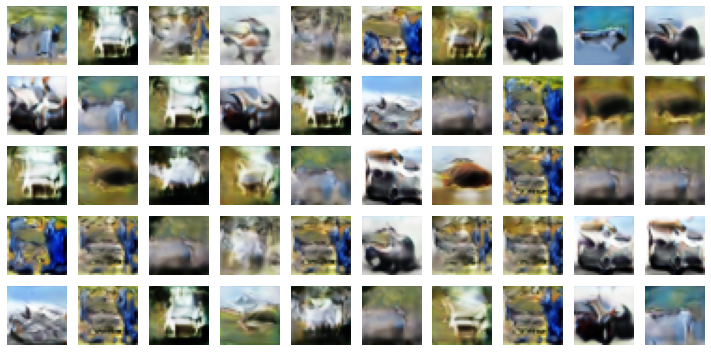

wandb: Adding directory to artifact (./Discriminator-Epoch89)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch89)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6187 - g_loss: 0.9101 - val_kid: 0.0044
Epoch 91/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6299 - g_loss: 0.8975

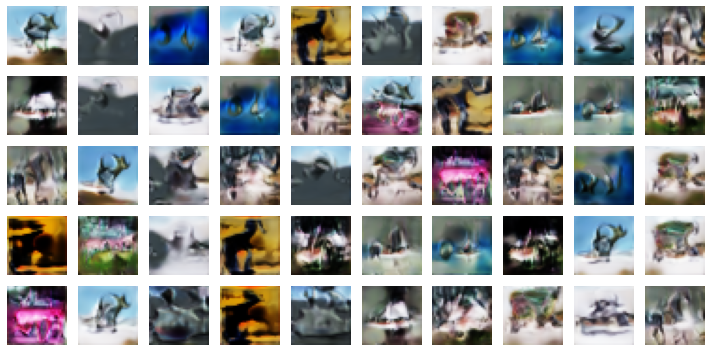

wandb: Adding directory to artifact (./Discriminator-Epoch90)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch90)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6299 - g_loss: 0.8974 - val_kid: 0.0151
Epoch 92/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6205 - g_loss: 0.9049

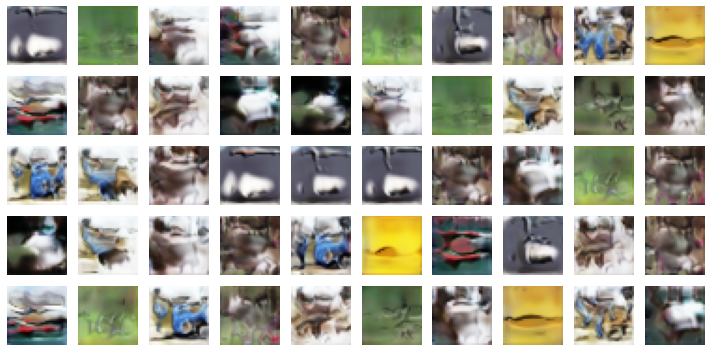

wandb: Adding directory to artifact (./Discriminator-Epoch91)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch91)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6203 - g_loss: 0.9047 - val_kid: 0.0115
Epoch 93/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6165 - g_loss: 0.9054

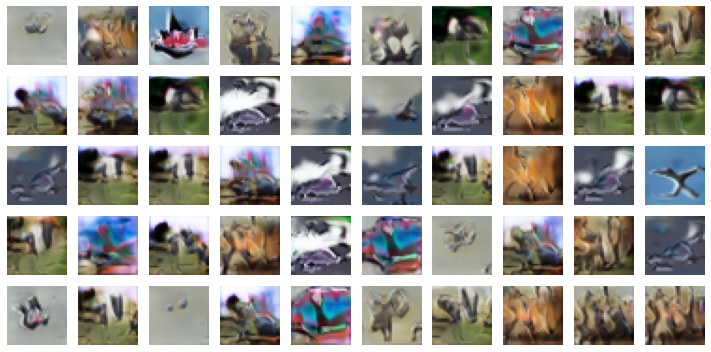

wandb: Adding directory to artifact (./Discriminator-Epoch92)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch92)... Done. 0.1s


391/391 [==============================] - 37s 94ms/step - d_loss: 0.6161 - g_loss: 0.9055 - val_kid: 0.0071
Epoch 94/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6207 - g_loss: 0.9014

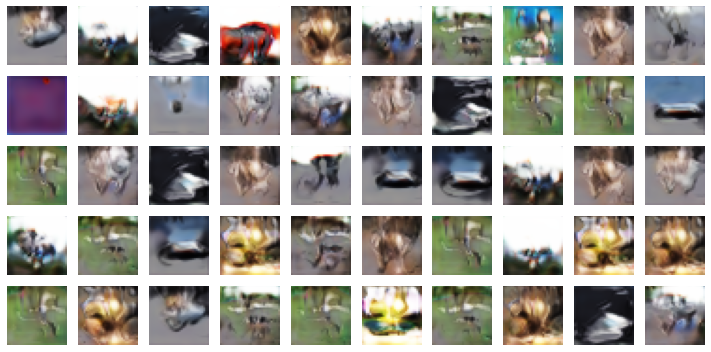

wandb: Adding directory to artifact (./Discriminator-Epoch93)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch93)... Done. 0.1s


391/391 [==============================] - 38s 98ms/step - d_loss: 0.6211 - g_loss: 0.9012 - val_kid: 0.0128
Epoch 95/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6181 - g_loss: 0.9184

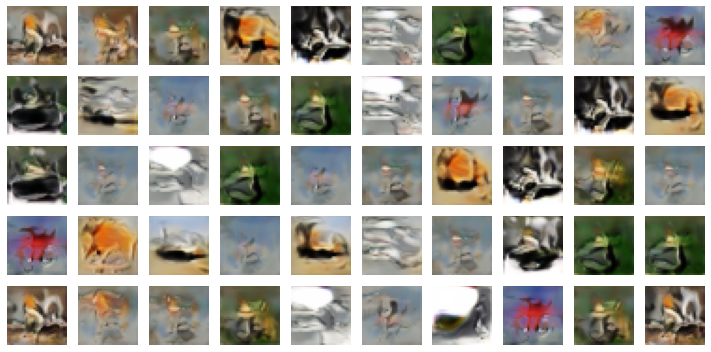

wandb: Adding directory to artifact (./Discriminator-Epoch94)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch94)... Done. 0.0s


391/391 [==============================] - 37s 95ms/step - d_loss: 0.6180 - g_loss: 0.9182 - val_kid: 0.0220
Epoch 96/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6155 - g_loss: 0.9189

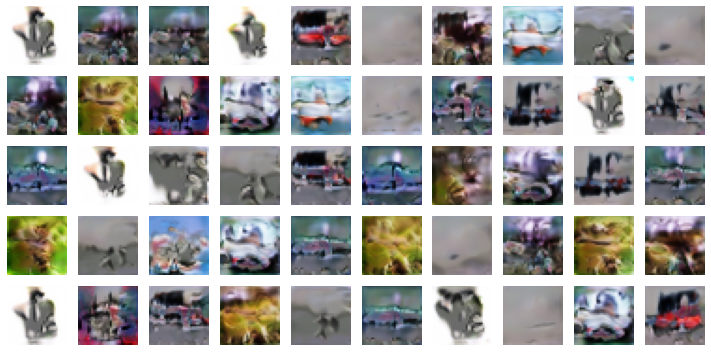

wandb: Adding directory to artifact (./Discriminator-Epoch95)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch95)... Done. 0.0s


391/391 [==============================] - 38s 97ms/step - d_loss: 0.6155 - g_loss: 0.9186 - val_kid: 0.0073
Epoch 97/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6265 - g_loss: 0.9065

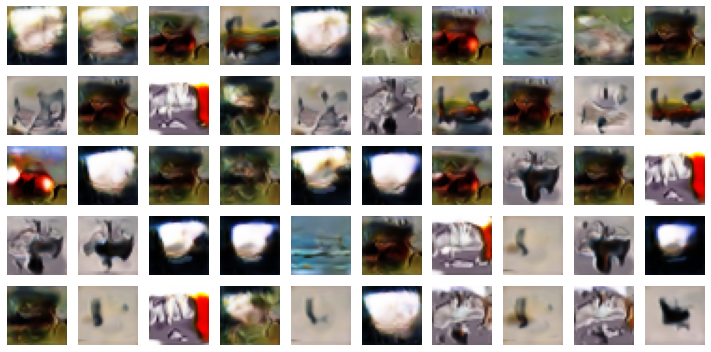

wandb: Adding directory to artifact (./Discriminator-Epoch96)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch96)... Done. 0.0s


391/391 [==============================] - 37s 94ms/step - d_loss: 0.6269 - g_loss: 0.9075 - val_kid: 0.0193
Epoch 98/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6250 - g_loss: 0.9059

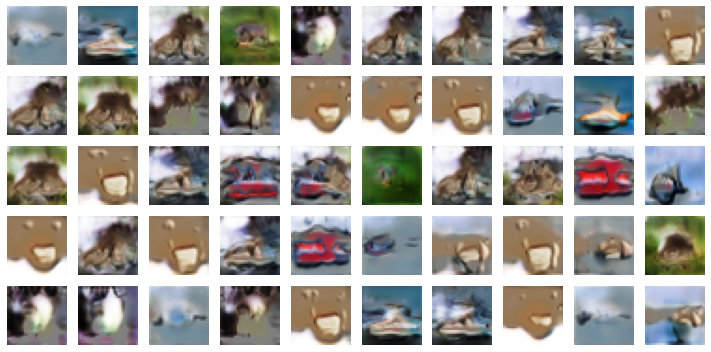

wandb: Adding directory to artifact (./Discriminator-Epoch97)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch97)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6251 - g_loss: 0.9058 - val_kid: 0.0136
Epoch 99/100
390/391 [============================>.] - ETA: 0s - d_loss: 0.6260 - g_loss: 0.9012

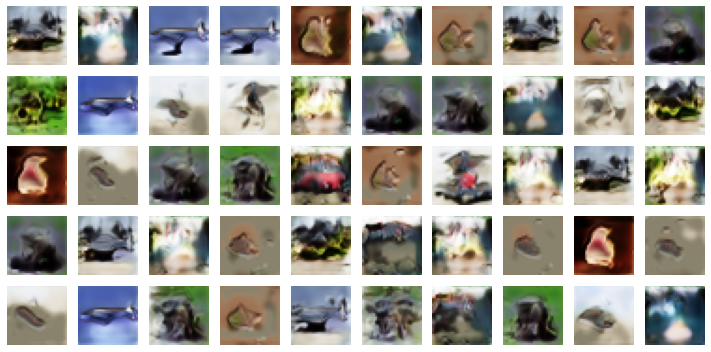

wandb: Adding directory to artifact (./Discriminator-Epoch98)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch98)... Done. 0.1s


391/391 [==============================] - 37s 93ms/step - d_loss: 0.6261 - g_loss: 0.9010 - val_kid: 0.0076
Epoch 100/100
391/391 [==============================] - ETA: 0s - d_loss: 0.6123 - g_loss: 0.9242

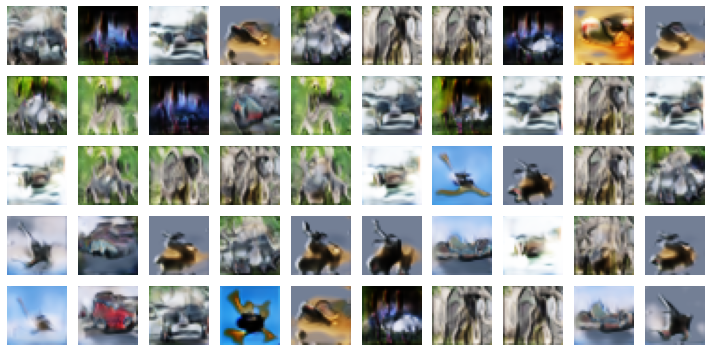

wandb: Adding directory to artifact (./Discriminator-Epoch99)... Done. 0.0s
wandb: Adding directory to artifact (./Generator-Epoch99)... Done. 0.0s


391/391 [==============================] - 38s 96ms/step - d_loss: 0.6123 - g_loss: 0.9243 - val_kid: 0.0086


In [ ]:

from tensorflow.keras.datasets.cifar10 import load_data
wandb.login(key = '')
(x_train, _), (x_val,_) = load_data() 
# Create a GAN object
x_val =(x_val - 127.5) / 127.5
# print(len(x_val))


gan = GAN(discriminator= createcustomvgg_discriminator() , generator=create_generator() , latdim = 100  )

# Specify the optimizers
optimizers = {
    "d_optimizer": tf.keras.optimizers.Adam(learning_rate = 0.0002,beta_1=0.5 ),
    "g_optimizer": tf.keras.optimizers.Adam(learning_rate = 0.0002 , beta_1 =0.5 ),

}

# Specify the losses and metrics
loss = {"d_loss":  tf.keras.losses.BinaryCrossentropy(from_logits=False) , "g_loss": tf.keras.losses.BinaryCrossentropy(from_logits=False)} # trying default binary cross entropy 
# metrics = {"image_loss": metric_fn, "g_loss": None}
# Compile
gan.compile(optimizers=optimizers, loss=loss)
# Start the training and sit back
x_train =(x_train - 127.5) / 127.5
wandb.init(project = 'Vanilla GAN')
import math 
BATCH_SIZE = 128
history = gan.fit(tf.data.Dataset.from_tensor_slices(x_train).batch(BATCH_SIZE), epochs=100 ,   test_step_per_epoch = int(math.ceil((1. * len(x_val)) / BATCH_SIZE)) , validation_data = tf.data.Dataset.from_tensor_slices(x_val).batch(BATCH_SIZE) , callbacks = [
 
    ImageLogger( latent_dim = 100, num_col = 10  , num_row = 5 ) , 
    WandbModelLogger()

    ] )
wandb.finish() 
print( )
# fidhistory = gan.fid_history

In [ ]:
print(history.history)

In [ ]:
def plotlearningcurve(history):
    plt.figure(figsize = (16,9))
    plt.subplot(121)
    plt.plot(history.history['d_loss'] , label = 'Discriminator Loss')
    plt.plot(history.history['g_loss'] , label = 'Generator Loss')
    plt.title('Learning Curve - loss')
    plt.ylabel('loss')
    plt.xlabel('Epoch')
    plt.legend( loc='upper left')
    plt.ylim(bottom = 0 )

    plt.subplot(122)
    plt.plot(history.history['val_kid'] , label = 'KID')
    # plt.plot(history.history['val_loss'] , label = 'Validation Accuracy')
    plt.title('Learning Curve - KID')
    plt.ylabel('KID')
    plt.xlabel('Epoch')


    plt.legend( loc='upper left')
    plt.show()

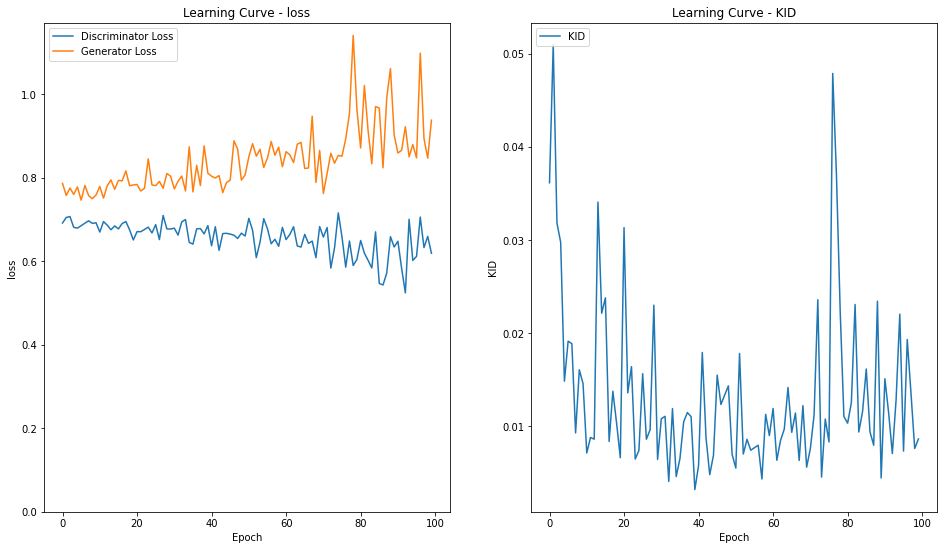

In [ ]:
plotlearningcurve(history)

- Training is very unstable , the discriminator and generator does not learn after  around 10 epochs, as discrminator and generator loss is stagnent afterwards
- Kernal inception distance is also very unstable as there are some very large fluctuations
- Neither the generator loss or discriminator loss increases/decreases quickly showing that none of the networks overpower the other one 
- This is most likely due to the gradient vanishing for the binary cross entropy loss used 

https://www.coursera.org/lecture/build-basic-generative-adversarial-networks-gans/problem-with-bce-loss-DzTcN

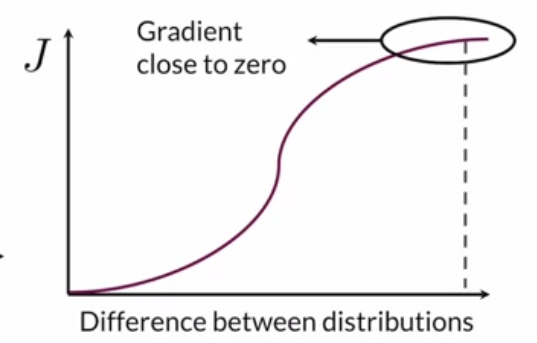

The flat regions of the Binary Cross Entropy loss function causes the gradients to train the generator to vanish and the training stops.



In [ ]:
gan.discriminator.save('bcediscriminator.h5')

In [ ]:
gan.generator.save('bcegenerator.h5')

In [ ]:
genera                                                                                                                                                                                                                                                                                                                                                                                                 

In [ ]:
generator = tf.keras.models.load_model('bcegenerator.h5' )

In [ ]:
import numpy
from numpy import cov
from numpy import trace
from numpy import iscomplexobj
from numpy import asarray
from numpy.random import randint
from scipy.linalg import sqrtm
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
from keras.datasets.mnist import load_data
# from skimage.transform import resize

def resizeforfid(image):
    image = 255*((image + 1)/2)
    image = tf.image.resize(image, (299, 299), method='nearest')
    image = tf.keras.applications.inception_v3.preprocess_input(image)

    return image
def calculate_fid(act1, act2):
    # calculate mean and covariance statistics
    #https://machinelearningmastery.com/how-to-implement-the-frechet-inception-distance-fid-from-scratch/
    incep= InceptionV3(include_top=False, pooling="avg", input_shape=(299,299,3))
    act1 = incep.predict(act1, verbose=0)
    act2 = incep.predict(act2, verbose=0)
    mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
    mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)
    # calculate sum squared difference between means
    ssdiff = numpy.sum((mu1 - mu2)**2.0)
    # calculate sqrt of product between cov
    covmean = sqrtm(sigma1.dot(sigma2))
    # check and correct imaginary numbers from sqrt
    if iscomplexobj(covmean):          
        covmean = covmean.real
    # calculate score
    fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

def preparefiddata(realimage, generator):
    realimages = tf.data.Dataset.from_tensor_slices(realimage).map(resizeforfid, num_parallel_calls=tf.data.AUTOTUNE).batch(batch_size=128, num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE
    fakeimages = generator(tf.random.normal((len(realimage),100)),training = False)

    fakeimgdataset =tf.data.Dataset.from_tensor_slices(fakeimages).map(resizeforfid, num_parallel_calls=tf.data.AUTOTUNE).batch(batch_size=128, num_parallel_calls=tf.data.AUTOTUNE) .prefetch(tf.data.AUTOTUNE)

    return calculate_fid(realimages, fakeimgdataset)



In [ ]:

from tensorflow.keras.datasets.cifar10 import load_data
(x_train, _), (x_val,_) = load_data() 
x_val =(x_val - 127.5) / 127.5
fidscore =preparefiddata(x_val, generator)
print(fidscore)

125.89785529833726


The high frechet inception distance reflects the poor image quality and mode collaspe of the baseline bce model
